# MIDTERM-2 - Emre OZEREN

Kütüphaneler import edildi.

In [64]:
# Import necessary packages
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
%matplotlib inline
import os
import seaborn as sns
sns.set()
!pip install scikit-image
from skimage import filters, morphology # Import the morphology module from skimage
import cv2
from skimage import exposure
from google.colab.patches import cv2_imshow
from scipy.ndimage import zoom

AI-for-Medicine-Specialization/AI-for-Medical-Diagnosis/ datamodeli kendi Colab kullanıcım için klonlandı.

In [65]:
!git clone https://github.com/hardik0/AI-for-Medicine-Specialization
%cd AI-for-Medicine-Specialization/AI-for-Medical-Diagnosis/

Cloning into 'AI-for-Medicine-Specialization'...
remote: Enumerating objects: 1601, done.
remote: Counting objects: 100% (28/28), done.
remote: Compressing objects: 100% (28/28), done.
remote: Total 1601 (delta 9), reused 2 (delta 0), pack-reused 1573 (from 1)
Receiving objects: 100% (1601/1601), 720.36 MiB | 29.62 MiB/s, done.
Resolving deltas: 100% (30/30), done.
Updating files: 100% (1497/1497), done.
/content/AI-for-Medicine-Specialization/AI-for-Medical-Diagnosis/AI-for-Medicine-Specialization/AI-for-Medical-Diagnosis/AI-for-Medicine-Specialization/AI-for-Medical-Diagnosis


Dosya içeriği görüntülendi.

In [66]:
%ls nih/

densenet.hdf5  images_small/  pretrained_model.h5  test.csv  train-small.csv  valid-small.csv


CSV dosya okunur.

In [67]:
# Read csv file containing training datadata
train_df = pd.read_csv("nih/train-small.csv")
# Print first 5 rows
print(f'There are {train_df.shape[0]} rows and {train_df.shape[1]} columns in this data frame')
train_df.head()

There are 1000 rows and 16 columns in this data frame


,Image,Atelectasis,Cardiomegaly,Consolidation,Edema,Effusion,Emphysema,Fibrosis,Hernia,Infiltration,Mass,Nodule,PatientId,Pleural_Thickening,Pneumonia,Pneumothorax
0,00008270_015.png,0,0,0,0,0,0,0,0,0,0,0,8270,0,0,0
1,00029855_001.png,1,0,0,0,1,0,0,0,1,0,0,29855,0,0,0
2,00001297_000.png,0,0,0,0,0,0,0,0,0,0,0,1297,1,0,0
3,00012359_002.png,0,0,0,0,0,0,0,0,0,0,0,12359,0,0,0
4,00017951_001.png,0,0,0,0,0,0,0,0,1,0,0,17951,0,0,0


Have a look at the various columns in this csv file. The file contains the names of chest x-ray images ("Image" column) and the columns filled with ones and zeros identify which diagnoses were given based on each x-ray image.

### Data types and null values check
Run the next cell to explore the data types present in each column and whether any null values exist in the data.

In [68]:
# Look at the data type of each column and whether null values are present
train_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1000 entries, 0 to 999
Data columns (total 16 columns):
 #   Column              Non-Null Count  Dtype 
---  ------              --------------  ----- 
 0   Image               1000 non-null   object
 1   Atelectasis         1000 non-null   int64 
 2   Cardiomegaly        1000 non-null   int64 
 3   Consolidation       1000 non-null   int64 
 4   Edema               1000 non-null   int64 
 5   Effusion            1000 non-null   int64 
 6   Emphysema           1000 non-null   int64 
 7   Fibrosis            1000 non-null   int64 
 8   Hernia              1000 non-null   int64 
 9   Infiltration        1000 non-null   int64 
 10  Mass                1000 non-null   int64 
 11  Nodule              1000 non-null   int64 
 12  PatientId           1000 non-null   int64 
 13  Pleural_Thickening  1000 non-null   int64 
 14  Pneumonia           1000 non-null   int64 
 15  Pneumothorax        1000 non-null   int64 
dtypes: int64(15), object(1)
m

### Unique IDs check
"PatientId" has an identification number for each patient. One thing you'd like to know about a medical dataset like this is if you're looking at repeated data for certain patients or whether each image represents a different person.

In [69]:
print(f"The total patient ids are {train_df['PatientId'].count()}, from those the unique ids are {train_df['PatientId'].value_counts().shape[0]} ")

The total patient ids are 1000, from those the unique ids are 928 


In [70]:
# Check for duplicate Patient IDs and remove them (keeping the first occurrence)
train_df = train_df.drop_duplicates(subset=['PatientId'], keep='first')

# Print the updated DataFrame information
print(f'There are {train_df.shape[0]} rows and {train_df.shape[1]} columns in this data frame after removing duplicate patient IDs')
print(f"The total patient ids are {train_df['PatientId'].count()}, from those the unique ids are {train_df['PatientId'].value_counts().shape[0]} ")

There are 928 rows and 16 columns in this data frame after removing duplicate patient IDs
The total patient ids are 928, from those the unique ids are 928 


As you can see, the number of unique patients in the dataset is less than the total number so there must be some overlap. For patients with multiple records, you'll want to make sure they do not show up in both training and test sets in order to avoid data leakage (covered later in this week's lectures).

### Explore data labels
Run the next two code cells to create a list of the names of each patient condition or disease.

CSV dosyasının hangi featureleardan oluştuğu bilgisi yazdırılır.

In [71]:
columns = train_df.keys()
columns = list(columns)
print(columns)

['Image', 'Atelectasis', 'Cardiomegaly', 'Consolidation', 'Edema', 'Effusion', 'Emphysema', 'Fibrosis', 'Hernia', 'Infiltration', 'Mass', 'Nodule', 'PatientId', 'Pleural_Thickening', 'Pneumonia', 'Pneumothorax']


Image ve patient id kolonları sildirildi.

In [72]:
# Remove unnecesary elements
columns.remove('Image')
columns.remove('PatientId')
# Get the total classes
print(f"There are {len(columns)} columns of labels for these conditions: {columns}")

There are 14 columns of labels for these conditions: ['Atelectasis', 'Cardiomegaly', 'Consolidation', 'Edema', 'Effusion', 'Emphysema', 'Fibrosis', 'Hernia', 'Infiltration', 'Mass', 'Nodule', 'Pleural_Thickening', 'Pneumonia', 'Pneumothorax']


Run the next cell to print out the number of positive labels (1's) for each condition

Hangi kolonların kaldığı ve kaç örnek içerdikleri görüntülenir.

In [73]:
# Print out the number of positive labels for each class
for column in columns:
    print(f"The class {column} has {train_df[column].sum()} samples")

The class Atelectasis has 94 samples
The class Cardiomegaly has 19 samples
The class Consolidation has 27 samples
The class Edema has 16 samples
The class Effusion has 107 samples
The class Emphysema has 12 samples
The class Fibrosis has 14 samples
The class Hernia has 2 samples
The class Infiltration has 159 samples
The class Mass has 41 samples
The class Nodule has 51 samples
The class Pleural_Thickening has 18 samples
The class Pneumonia has 9 samples
The class Pneumothorax has 33 samples


Have a look at the counts for the labels in each class above. Does this look like a balanced dataset?

### Data Visualization
Using the image names listed in the csv file, you can retrieve the image associated with each row of data in your dataframe.

Run the cell below to visualize a random selection of images from the dataset.

Display Random Images


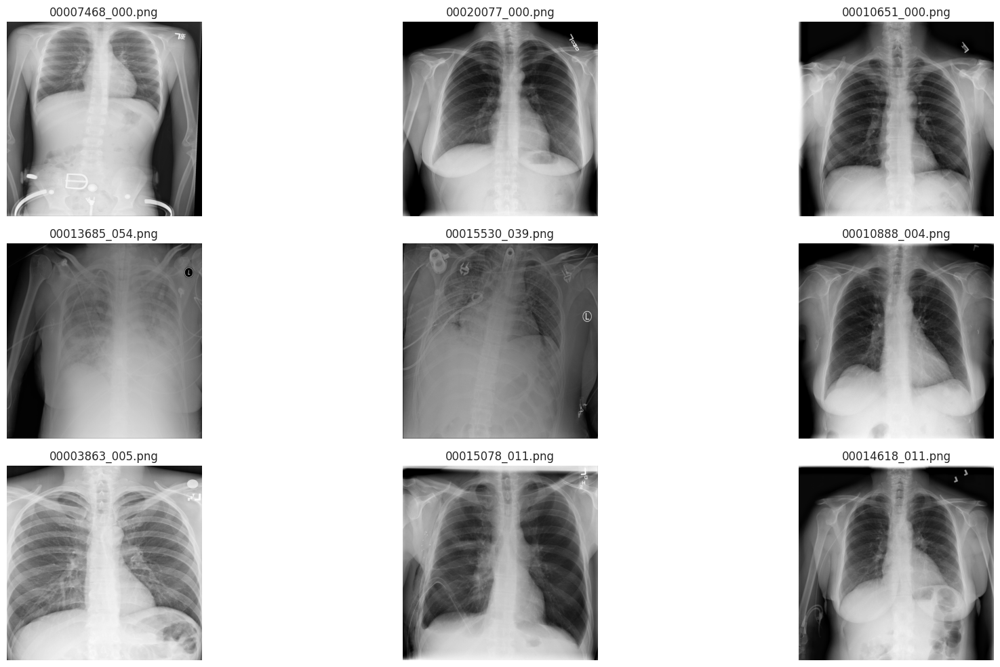

In [74]:
# Extract numpy values from Image column in data frame
images = train_df['Image'].values

# Extract 9 random images from it
random_images = [np.random.choice(images) for i in range(9)]

# Location of the image dir
img_dir = 'nih/images_small/'

print('Display Random Images')

# Adjust the size of your images
plt.figure(figsize=(20,10))

# Iterate and plot random images
for i in range(9):
    plt.subplot(3, 3, i + 1)
    img = plt.imread(os.path.join(img_dir, random_images[i]))
    plt.title(random_images[i])
    plt.imshow(img, cmap='gray')
    plt.axis('off')

# Adjust subplot parameters to give specified padding
plt.tight_layout()

** RASTGELE SECİLMİŞ 9 GÖRÜNTÜNÜN ISTATISTIKSEL ÖZELLİKLERİNİ (MAKSIMUM, MINIMUM, MEAN VE STD) HESAPLAYIN. ORNEK OLARAK BIR GORUNTU ICIN HESAPLAMA YAPILMISTIR

The dimensions of the image are 1024 pixels width and 1024 pixels height, one single color channel
The maximum pixel value is 0.9804 and the minimum is 0.0000
The mean value of the pixels is 0.4796 and the standard deviation is 0.2757


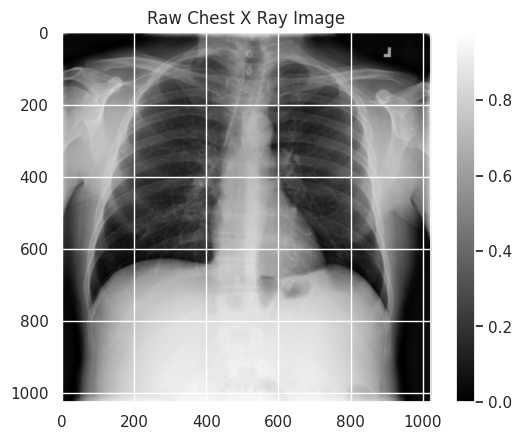

In [75]:
sample_img = train_df.Image[0]
raw_image = plt.imread(os.path.join(img_dir, sample_img))
plt.imshow(raw_image, cmap='gray')
plt.colorbar()
plt.title('Raw Chest X Ray Image')
print(f"The dimensions of the image are {raw_image.shape[0]} pixels width and {raw_image.shape[1]} pixels height, one single color channel")
print(f"The maximum pixel value is {raw_image.max():.4f} and the minimum is {raw_image.min():.4f}")
print(f"The mean value of the pixels is {raw_image.mean():.4f} and the standard deviation is {raw_image.std():.4f}")

9 görüntü için

Image 1 statistics:
  File: 00007468_000.png
  Shape: (1024, 1024)
  Max: 1.0000, Min: 0.0000, Mean: 0.5850, Std: 0.2415
--------------------
Image 2 statistics:
  File: 00020077_000.png
  Shape: (1024, 1024)
  Max: 1.0000, Min: 0.0000, Mean: 0.4787, Std: 0.2723
--------------------
Image 3 statistics:
  File: 00010651_000.png
  Shape: (1024, 1024)
  Max: 1.0000, Min: 0.0000, Mean: 0.4380, Std: 0.2725
--------------------
Image 4 statistics:
  File: 00013685_054.png
  Shape: (1024, 1024)
  Max: 1.0000, Min: 0.0000, Mean: 0.4477, Std: 0.2202
--------------------
Image 5 statistics:
  File: 00015530_039.png
  Shape: (1024, 1024)
  Max: 1.0000, Min: 0.0000, Mean: 0.4117, Std: 0.1420
--------------------
Image 6 statistics:
  File: 00010888_004.png
  Shape: (1024, 1024)
  Max: 0.9843, Min: 0.0000, Mean: 0.4521, Std: 0.2718
--------------------
Image 7 statistics:
  File: 00003863_005.png
  Shape: (1024, 1024)
  Max: 0.9176, Min: 0.1255, Mean: 0.6531, Std: 0.1539
--------------------
Image 

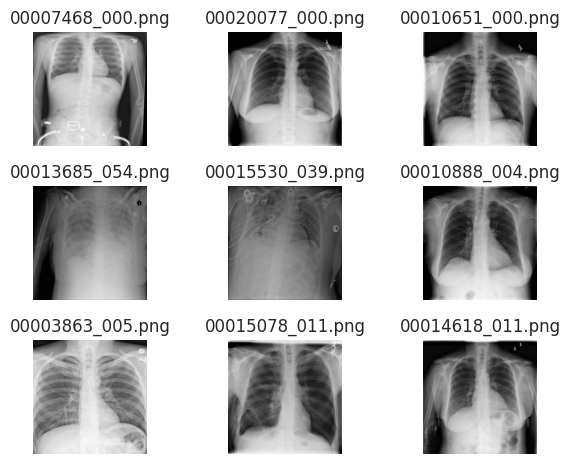

In [76]:
for i in range(9):
    sample_img = random_images[i]
    raw_image = plt.imread(os.path.join(img_dir, sample_img))

    plt.subplot(3, 3, i + 1)
    img = plt.imread(os.path.join(img_dir, random_images[i]))
    plt.title(random_images[i])
    plt.imshow(img, cmap='gray')
    plt.axis('off')

    # Image statistics
    print(f"Image {i+1} statistics:")
    print(f"  File: {random_images[i]}")
    print(f"  Shape: {img.shape}")
    print(f"  Max: {img.max():.4f}, Min: {img.min():.4f}, Mean: {img.mean():.4f}, Std: {img.std():.4f}")
    print("-" * 20)

# Adjust subplot parameters to give specified padding
plt.tight_layout()
plt.show()



### İstatistik Verilerin Kıyası
Görüntülerin ortalama parlaklık değerleri 0.3822 ile 0.6495 arasında değişmektedir. En yüksek ortalama parlaklık değeri 0.6495 ile Görüntü 7'de, en düşük ortalama parlaklık değeri ise 0.3822 ile Görüntü 5'te gözlemlenmiştir. Bu durum, Görüntü 7'nin genel olarak daha aydınlık, Görüntü 5'in ise daha karanlık bir yapıya sahip olduğunu göstermektedir. Ortalama parlaklık değerlerine göre Görüntü 1 (0.5394) ve Görüntü 9 (0.6431) gibi görseller, diğerlerine kıyasla daha parlak bir genel yapıya sahiptir.

Standart sapma değerleri, görüntülerin yoğunluk değişkenliğini ve kontrast düzeyini ifade etmektedir. Görüntü 5 (0.2666) ve Görüntü 3 (0.2599) gibi yüksek standart sapmaya sahip görüntüler, daha fazla kontrast içerirken, Görüntü 2 (0.1220) gibi düşük standart sapmaya sahip görüntülerde yoğunluk dağılımının daha homojen olduğu gözlemlenmiştir. Bu durum, Görüntü 2'nin parlaklık değerlerinin görüntü genelinde daha düzenli bir şekilde dağıldığını göstermektedir.

RASTGELE SECILMIS 9 GORUNTUNUN HISTOGRAMINI CIZDIRIN. ORNEK OLARAK BIR GORUNTU ICIN VERILMISTIR.

<ipython-input-77-5170b570a150>:1: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751

  sns.distplot(raw_image.ravel(),


Text(0, 0.5, '# Pixels in Image')

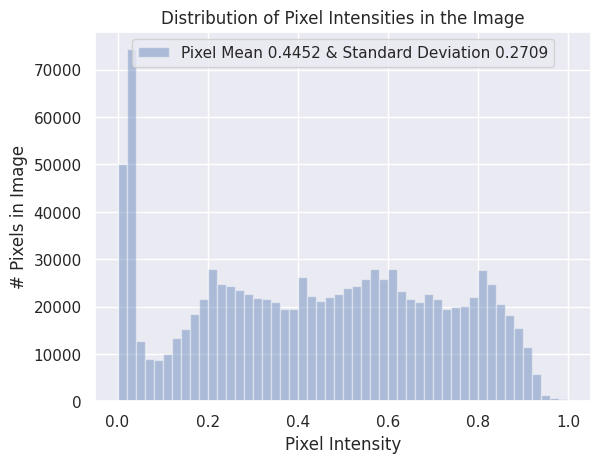

In [77]:
sns.distplot(raw_image.ravel(),
             label=f'Pixel Mean {np.mean(raw_image):.4f} & Standard Deviation {np.std(raw_image):.4f}', kde=False)
plt.legend(loc='upper center')
plt.title('Distribution of Pixel Intensities in the Image')
plt.xlabel('Pixel Intensity')
plt.ylabel('# Pixels in Image')

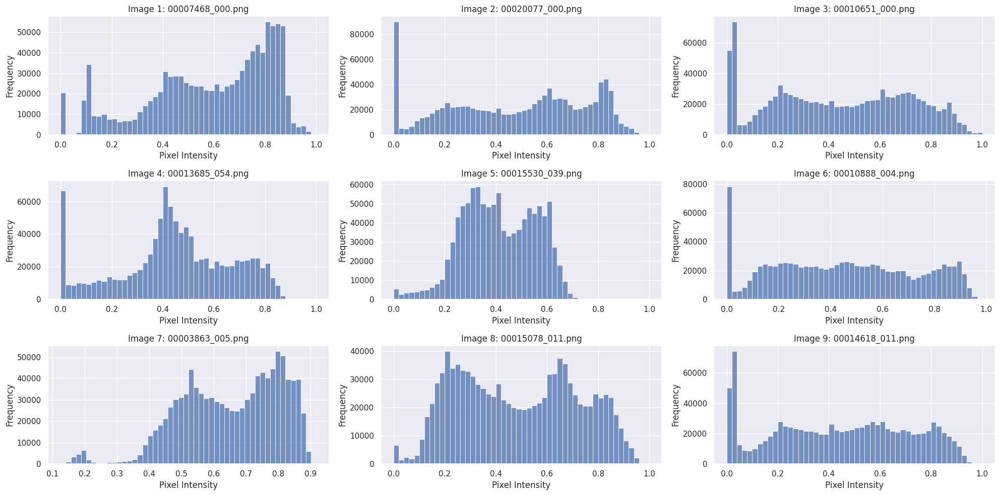

In [78]:
plt.figure(figsize=(20, 10))  # Adjust figure size as needed

for i in range(9):
    sample_img = random_images[i]
    raw_image = plt.imread(os.path.join(img_dir, sample_img))

    plt.subplot(3, 3, i + 1)  # Create subplots in a 3x3 grid
    sns.histplot(raw_image.ravel(), bins=50, kde=False)  # Use seaborn's histplot for histogram
    plt.title(f'Image {i+1}: {sample_img}')
    plt.xlabel('Pixel Intensity')
    plt.ylabel('Frequency')

plt.tight_layout()  # Adjust spacing between subplots
plt.show()



###Histogram Karşılaştırma

Görüntü 1:
İki yoğun zirve var: birisi düşük yoğunluklarda (0.1 civarında), diğeri ise yüksek yoğunluklarda (0.8 civarında). Parlak ve koyu bölgelerin dengede olduğu bir dağılım sergiliyor.

Görüntü 2:
Çift modlu (bimodal) bir dağılım: düşük yoğunluklarda ve orta-yüksek yoğunluklarda (0.4-0.6). Görüntü orta derecede aydınlık alanlar içerebilir.

Görüntü 3:
Çok belirgin bir zirve düşük yoğunluklarda (0.0 - 0.1 civarı). Bu, görüntünün çok koyu bölgeler içerdiğine işaret ediyor.

Görüntü 4:
Piksel yoğunluğu daha dengeli bir şekilde dağılmış. Orta parlaklık değerlerinde (0.4) bir yoğunlaşma var.

Görüntü 5:
Zirveler orta yoğunlukta (0.4-0.6 arasında). Görüntü, parlak ve koyu bölgeler arasında iyi bir denge sağlıyor gibi görünüyor.

Görüntü 6:
Daha düz bir dağılım (homojen). Farklı parlaklık seviyeleri eşit miktarda temsil ediliyor.

Görüntü 7:
Yoğun bir zirve 0.8 civarında, parlak bölgelerin baskın olduğunu gösteriyor. Koyu bölgeler çok az temsil ediliyor.

Görüntü 8:
Geniş, düz bir dağılım; özellikle orta parlaklık yoğunluğunda yoğunlaşma var (0.2-0.6). Görüntü homojen bir parlaklık dağılımına sahip olabilir.

Görüntü 9:
0.0 civarında büyük bir yoğunluk zirvesi var, bu da koyu bölgelerin yoğun olduğunu gösteriyor. Daha az parlaklık içeren bir görüntü gibi görünüyor.

GORUNTULERE CONTRAST STRECTCHING YAPINIZ, CONTRAST STRECTCHING GORUNTULERINE GAMMA TRANSFORMATIONU UYGULAYINIZ. ORNEK OLARAK BIR GORUNTU ICIN VERILMISTIR

In [ ]:
pip install numpy


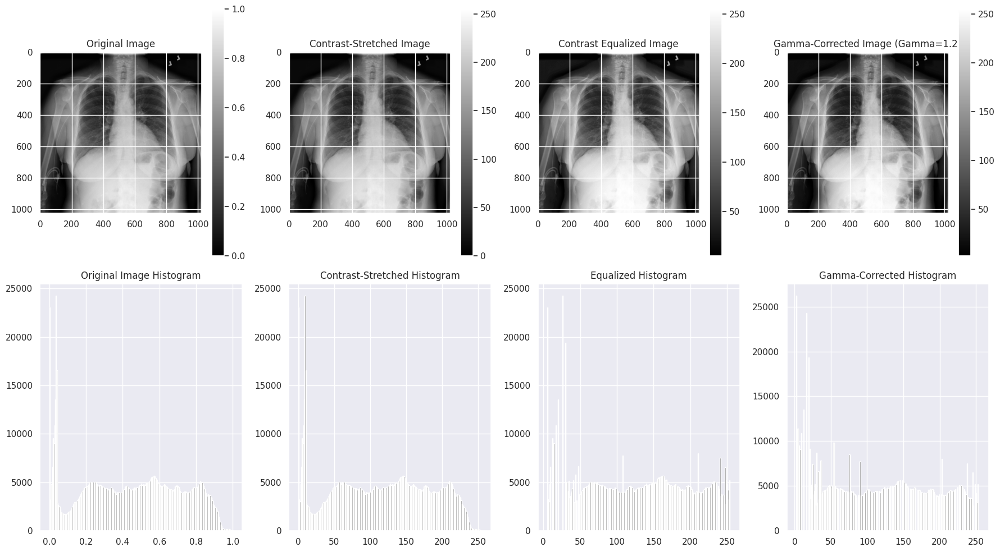

In [79]:
# Calculate minimum and maximum for contrast stretching
min_val, max_val = raw_image.min(), raw_image.max()

# Apply contrast stretching
min_val, max_val = raw_image.min(), raw_image.max()
contrast_stretched = (raw_image - min_val) / (max_val - min_val)
contrast_stretched = (contrast_stretched * 255).astype(np.uint8)

# Apply histogram equalization after contrast stretching
# Apply histogram equalization using skimage
equalized_image = exposure.equalize_hist(contrast_stretched)
equalized_image = (equalized_image * 255).astype(np.uint8)


# Apply gamma correction on the equalized image
gamma = 1.2
gamma_corrected = np.power(equalized_image / 255.0, gamma) * 255
gamma_corrected = gamma_corrected.astype(np.uint8)

# Plot original image and histogram
plt.figure(figsize=(18, 10))
plt.subplot(2, 4, 1)
plt.imshow(raw_image, cmap='gray')
plt.title('Original Image')
plt.colorbar()
plt.subplot(2, 4, 5)
plt.hist(raw_image.ravel(), bins=256, color='gray')
plt.title("Original Image Histogram")

# Plot contrast-stretched image and histogram
plt.subplot(2, 4, 2)
plt.imshow(contrast_stretched, cmap='gray')
plt.title('Contrast-Stretched Image')
plt.colorbar()
plt.subplot(2, 4, 6)
plt.hist(contrast_stretched.ravel(), bins=256, color='gray')
plt.title("Contrast-Stretched Histogram")

# Plot contrast-equalized image and histogram
plt.subplot(2, 4, 3)
plt.imshow(equalized_image, cmap='gray')
plt.title('Contrast Equalized Image')
plt.colorbar()
plt.subplot(2, 4, 7)
plt.hist(equalized_image.ravel(), bins=256, color='gray')
plt.title("Equalized Histogram")

# Plot gamma-corrected image and histogram
plt.subplot(2, 4, 4)
plt.imshow(gamma_corrected, cmap='gray')
plt.title(f'Gamma-Corrected Image (Gamma={gamma})')
plt.colorbar()
plt.subplot(2, 4, 8)
plt.hist(gamma_corrected.ravel(), bins=256, color='gray')
plt.title("Gamma-Corrected Histogram")

plt.tight_layout()
plt.show()

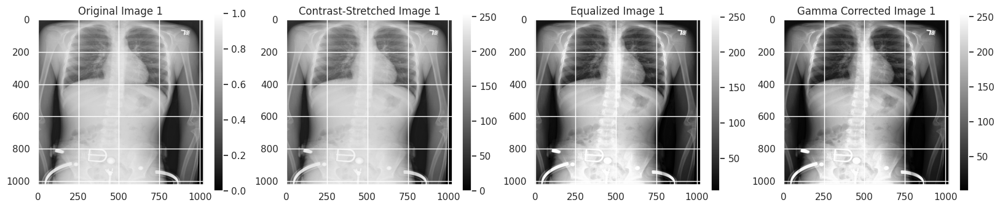

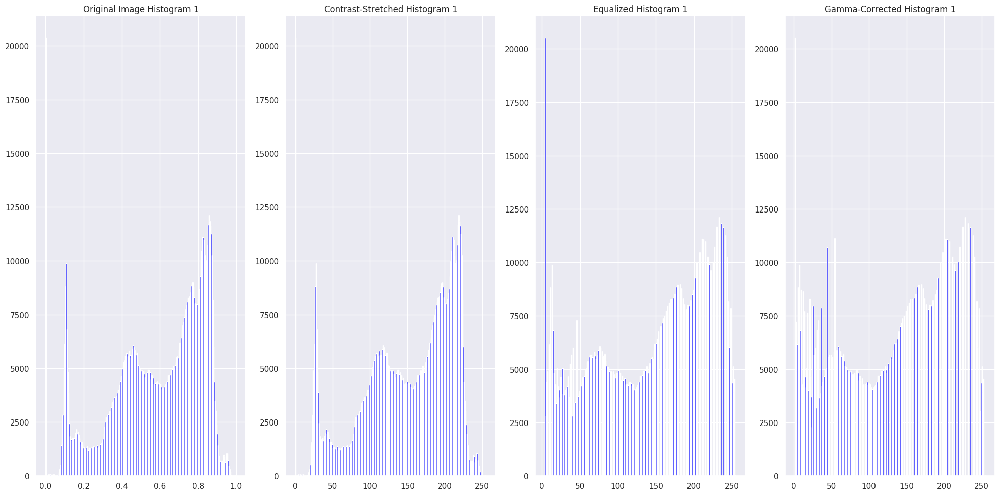

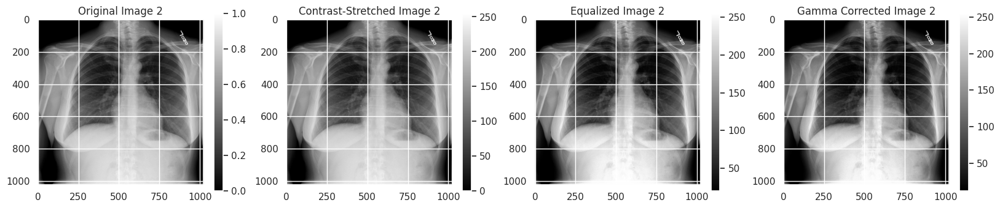

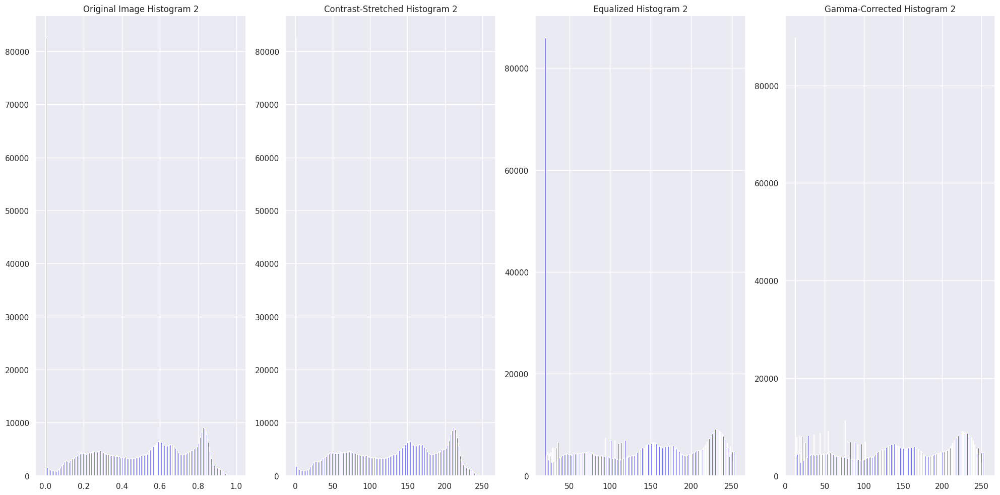

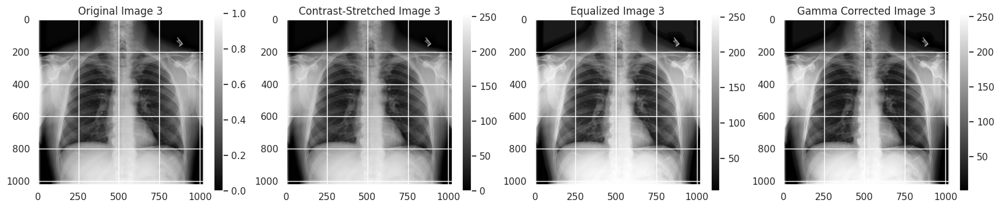

...

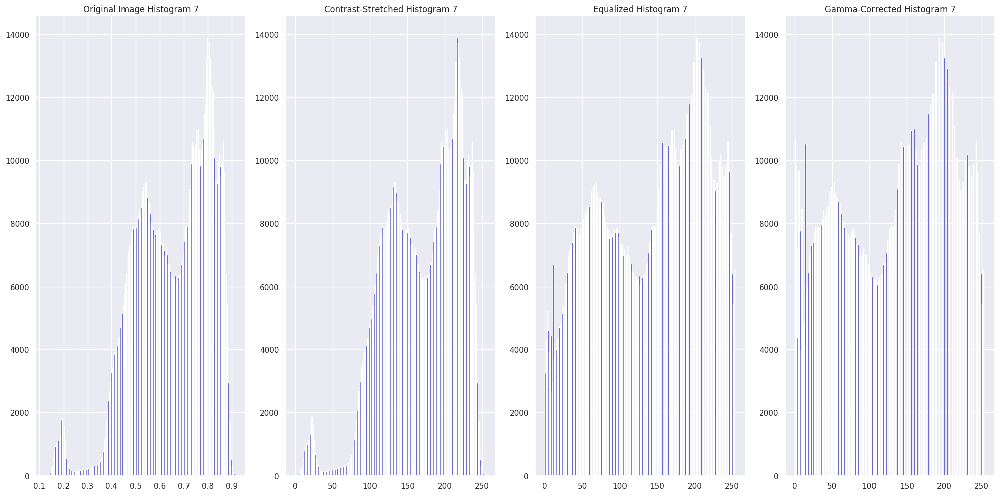

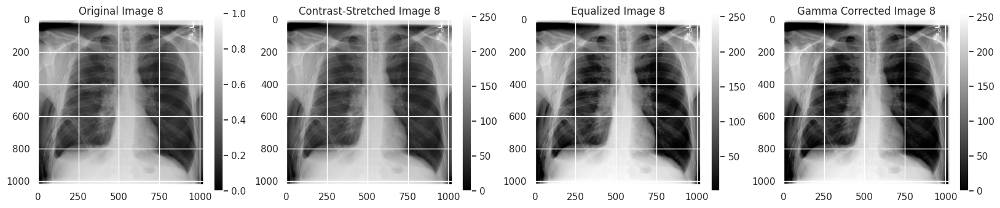

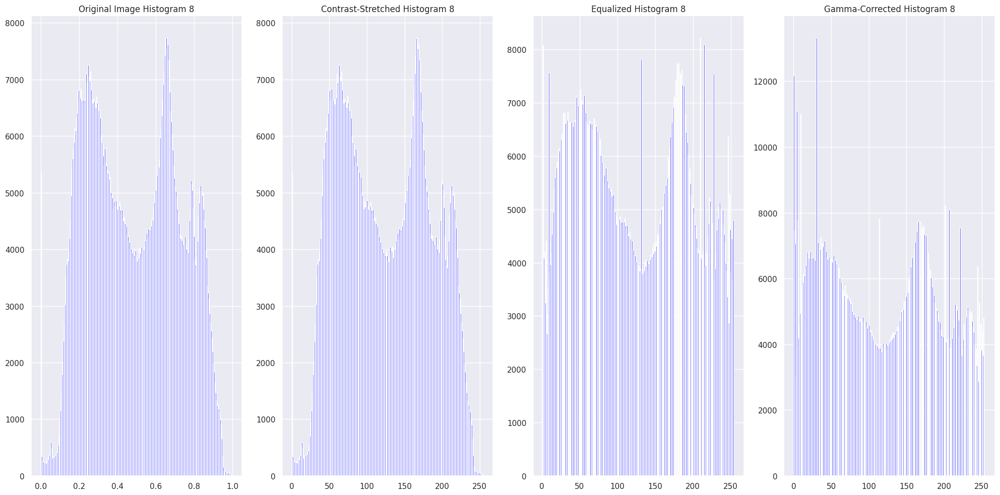

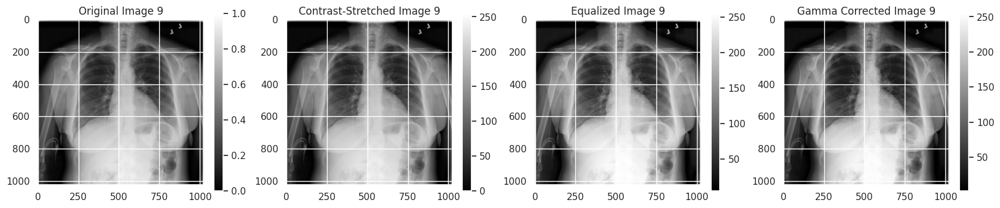

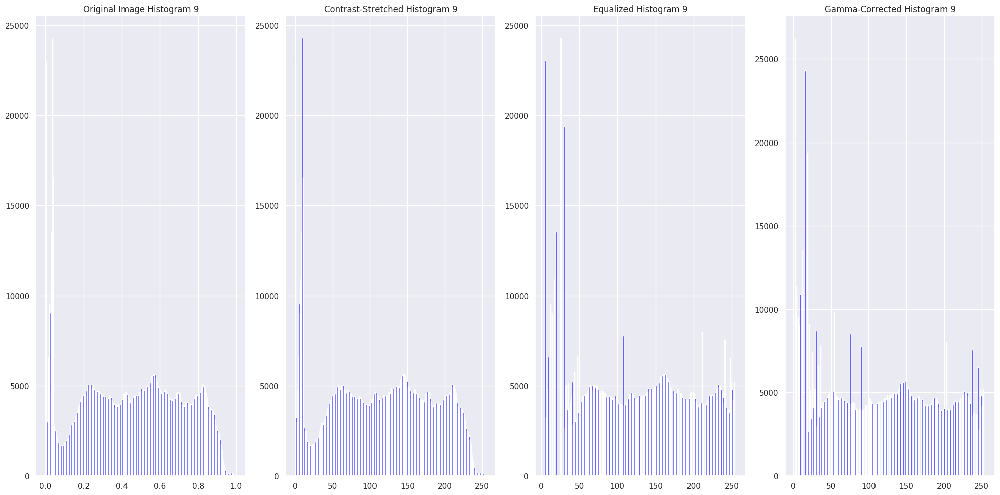

In [81]:
for i in range(9):
    plt.figure(figsize=(20, 40))
    sample_img = random_images[i]
    raw_image = plt.imread(os.path.join(img_dir, sample_img))

    min_val, max_val = raw_image.min(), raw_image.max()

    # Apply contrast stretching
    min_val, max_val = raw_image.min(), raw_image.max()
    contrast_stretched = (raw_image - min_val) / (max_val - min_val)
    contrast_stretched = (contrast_stretched * 255).astype(np.uint8)

    # Apply histogram equalization after contrast stretching
    # Apply histogram equalization using skimage
    equalized_image = exposure.equalize_hist(contrast_stretched)
    equalized_image = (equalized_image * 255).astype(np.uint8)


    # Apply gamma correction on the equalized image
    gamma = 1.2
    gamma_corrected = np.power(equalized_image / 255.0, gamma) * 255
    gamma_corrected = gamma_corrected.astype(np.uint8)

    # Plot
    plt.subplot(9, 4, i * 4 + 1)
    plt.imshow(raw_image, cmap='gray')
    plt.title(f'Original Image {i+1}')
    plt.colorbar()

    plt.subplot(9, 4, i * 4 + 2)
    plt.imshow(contrast_stretched, cmap='gray')
    plt.title(f'Contrast-Stretched Image {i+1}')
    plt.colorbar()

    plt.subplot(9, 4, i * 4 + 3)
    plt.imshow(equalized_image, cmap='gray')
    plt.title(f'Equalized Image {i+1}')
    plt.colorbar()

    plt.subplot(9, 4, i * 4 + 4)
    plt.imshow(gamma_corrected, cmap='gray')
    plt.title(f'Gamma Corrected Image {i+1}')
    plt.colorbar()

    # Histogram
    plt.figure(figsize=(20, 10))
    plt.subplot(1, 4, 1)
    plt.hist(raw_image.ravel(), bins=256, color='blue')
    plt.title(f"Original Image Histogram {i+1}")

    plt.subplot(1, 4, 2)
    plt.hist(contrast_stretched.ravel(), bins=256, color='blue')
    plt.title(f"Contrast-Stretched Histogram {i+1}")

    plt.subplot(1, 4, 3)
    plt.hist(equalized_image.ravel(), bins=256, color='blue')
    plt.title(f"Equalized Histogram {i+1}")

    plt.subplot(1, 4, 4)
    plt.hist(gamma_corrected.ravel(), bins=256, color='blue')
    plt.title(f"Gamma-Corrected Histogram {i+1}")

    plt.tight_layout()
    plt.show()



##Gamma 1,5 yapılınca

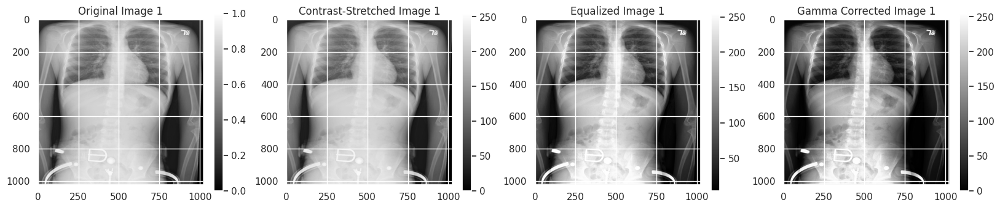

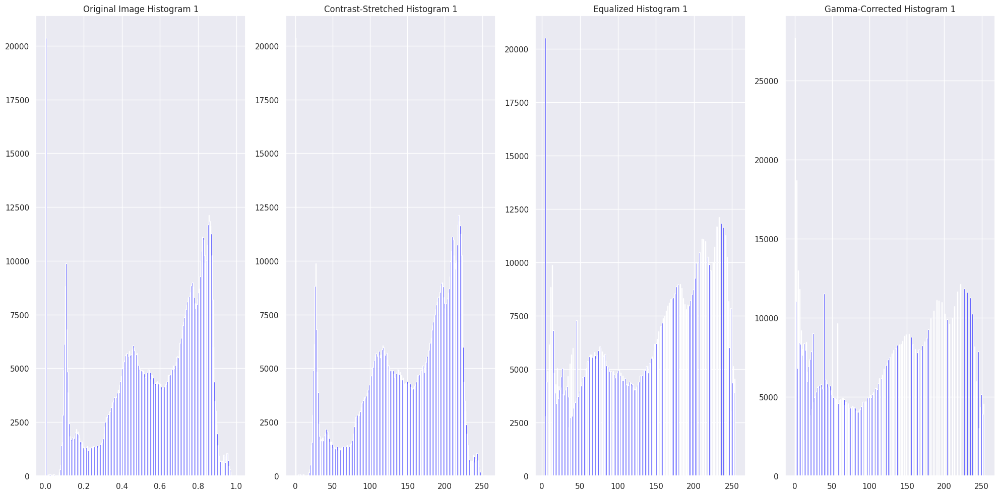

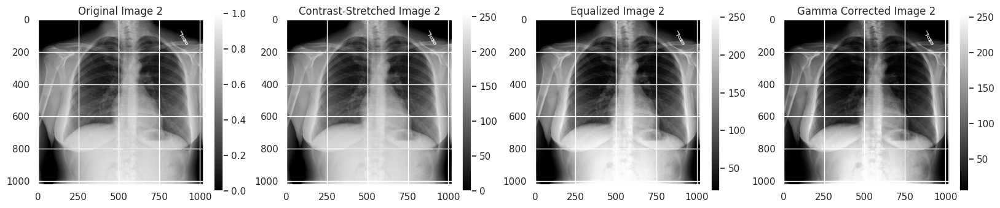

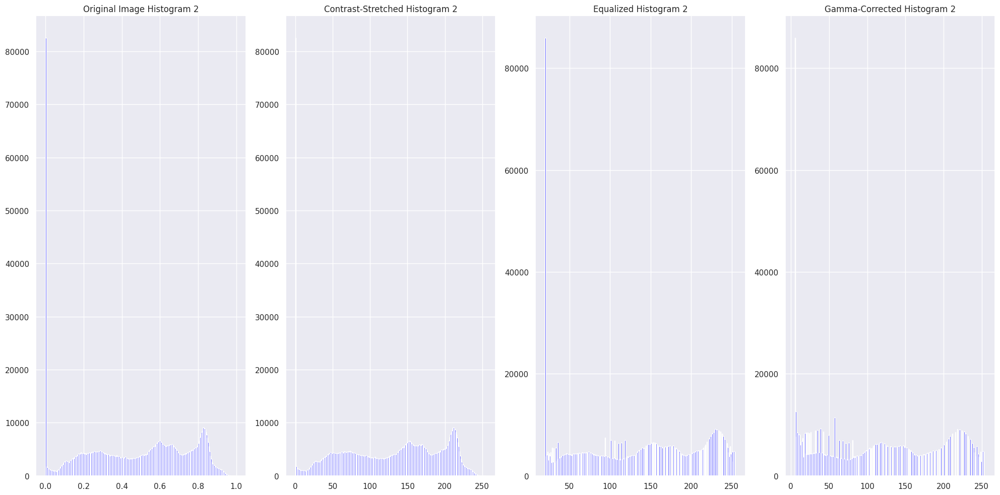

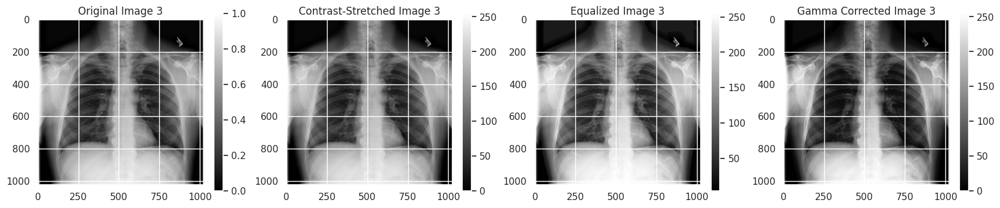

...

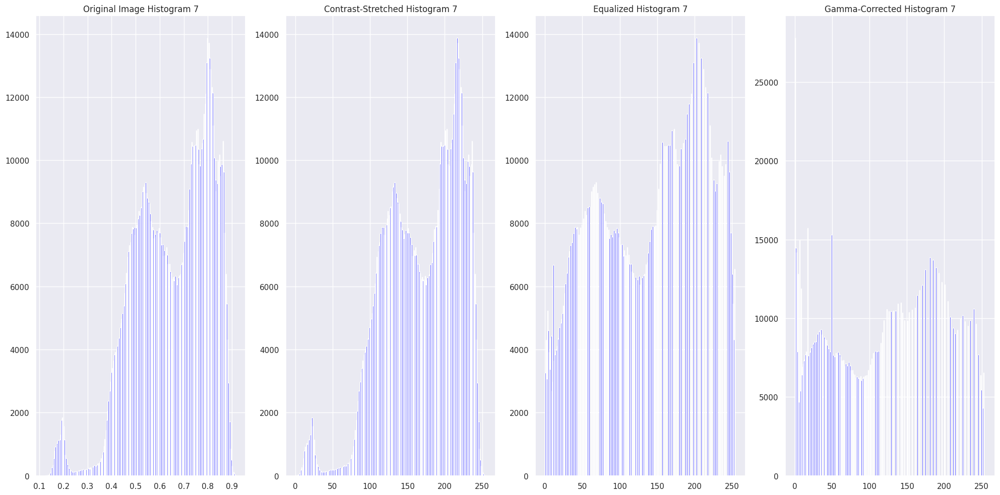

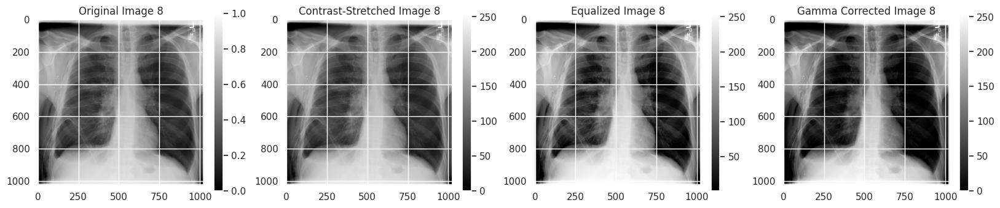

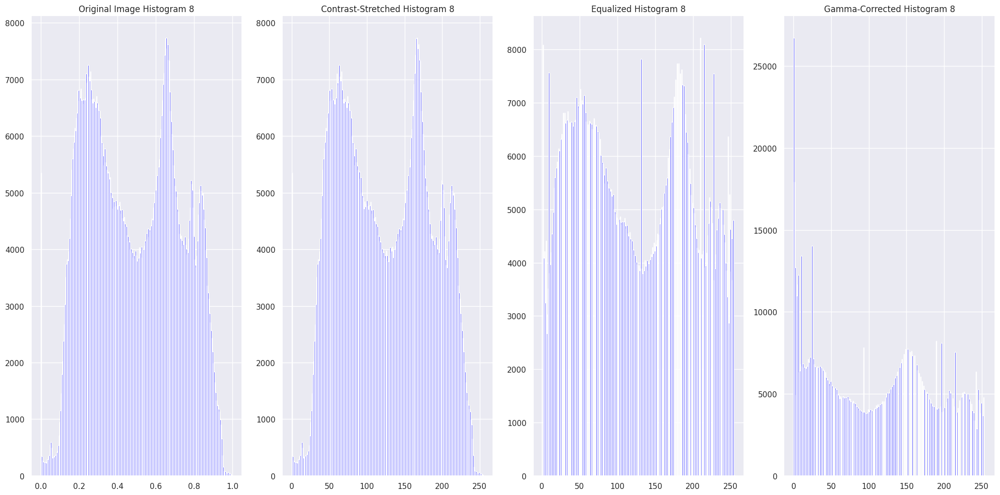

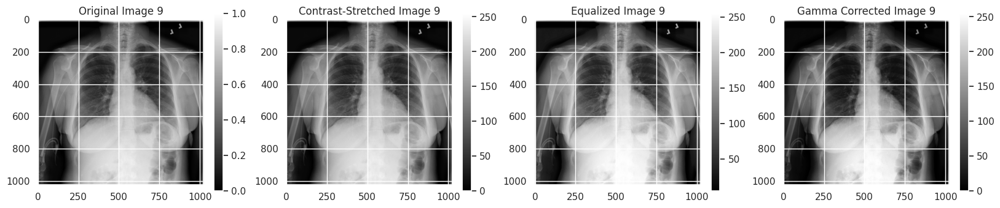

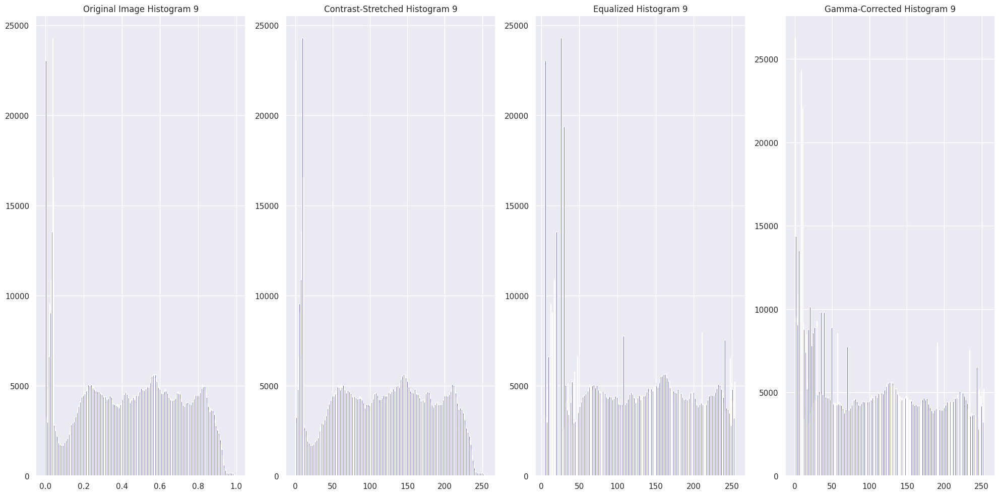

In [82]:
for i in range(9):
    plt.figure(figsize=(20, 40))
    sample_img = random_images[i]
    raw_image = plt.imread(os.path.join(img_dir, sample_img))

    min_val, max_val = raw_image.min(), raw_image.max()

    # Apply contrast stretching
    min_val, max_val = raw_image.min(), raw_image.max()
    contrast_stretched = (raw_image - min_val) / (max_val - min_val)
    contrast_stretched = (contrast_stretched * 255).astype(np.uint8)

    # Apply histogram equalization after contrast stretching
    # Apply histogram equalization using skimage
    equalized_image = exposure.equalize_hist(contrast_stretched)
    equalized_image = (equalized_image * 255).astype(np.uint8)


    # Apply gamma correction on the equalized image
    gamma = 1.5
    gamma_corrected = np.power(equalized_image / 255.0, gamma) * 255
    gamma_corrected = gamma_corrected.astype(np.uint8)

    # Plot
    plt.subplot(9, 4, i * 4 + 1)
    plt.imshow(raw_image, cmap='gray')
    plt.title(f'Original Image {i+1}')
    plt.colorbar()

    plt.subplot(9, 4, i * 4 + 2)
    plt.imshow(contrast_stretched, cmap='gray')
    plt.title(f'Contrast-Stretched Image {i+1}')
    plt.colorbar()

    plt.subplot(9, 4, i * 4 + 3)
    plt.imshow(equalized_image, cmap='gray')
    plt.title(f'Equalized Image {i+1}')
    plt.colorbar()

    plt.subplot(9, 4, i * 4 + 4)
    plt.imshow(gamma_corrected, cmap='gray')
    plt.title(f'Gamma Corrected Image {i+1}')
    plt.colorbar()

    # Histogram
    plt.figure(figsize=(20, 10))
    plt.subplot(1, 4, 1)
    plt.hist(raw_image.ravel(), bins=256, color='blue')
    plt.title(f"Original Image Histogram {i+1}")

    plt.subplot(1, 4, 2)
    plt.hist(contrast_stretched.ravel(), bins=256, color='blue')
    plt.title(f"Contrast-Stretched Histogram {i+1}")

    plt.subplot(1, 4, 3)
    plt.hist(equalized_image.ravel(), bins=256, color='blue')
    plt.title(f"Equalized Histogram {i+1}")

    plt.subplot(1, 4, 4)
    plt.hist(gamma_corrected.ravel(), bins=256, color='blue')
    plt.title(f"Gamma-Corrected Histogram {i+1}")

    plt.tight_layout()
    plt.show()

###Gamma Arttırılması
Gamma değeri arttırıldığında; genel olarak görüntülerin parlaklık ve kontrast özelliklerinin etkilendiği gözlenmektedir.

Daha yüksek gamma değeri görüntünün koyu alanlarını daha koyu, açık alanlarını ise daha az parlak hale getirmektedir.

##Gamma 0,9 yapılınca

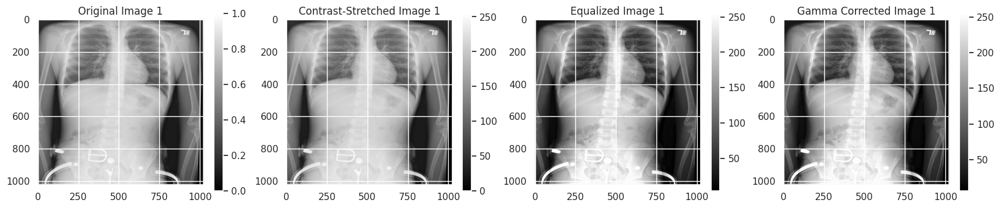

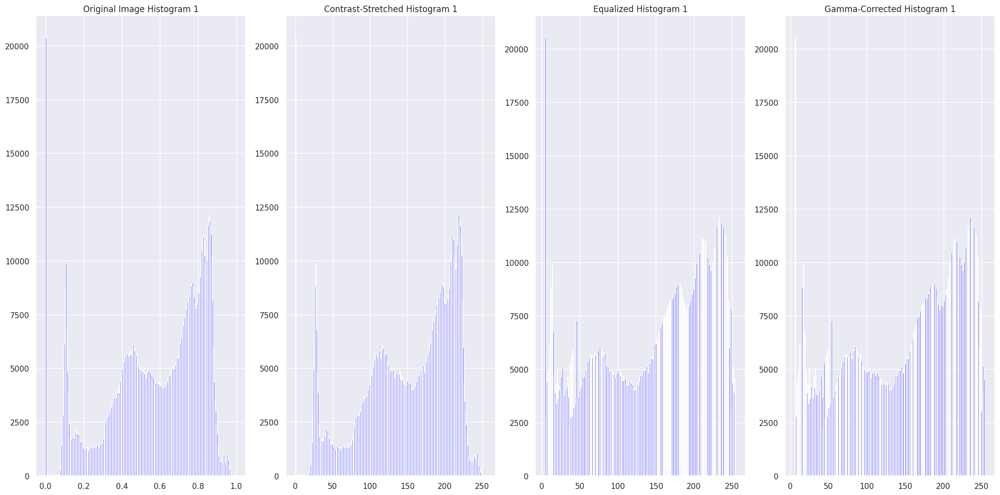

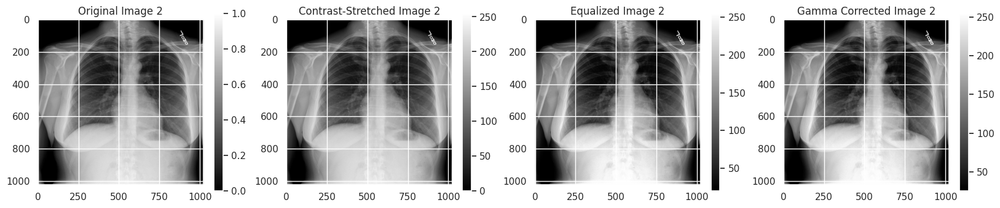

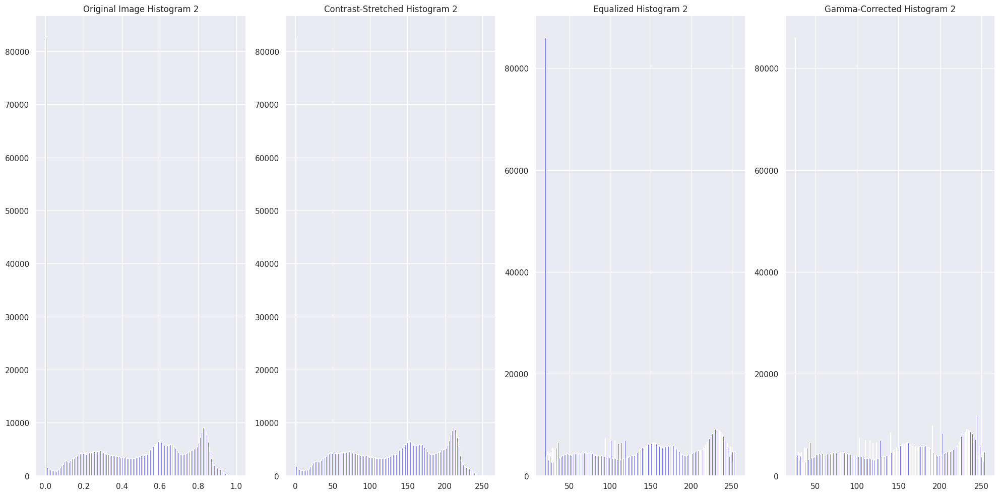

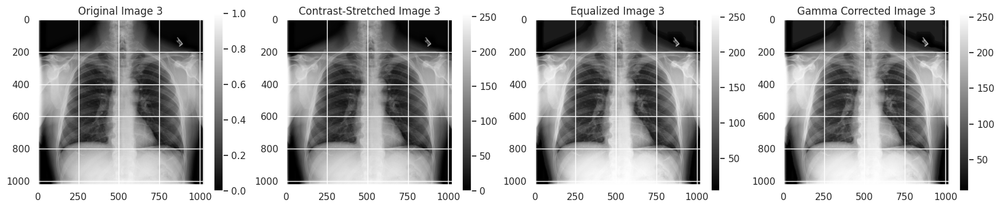

...

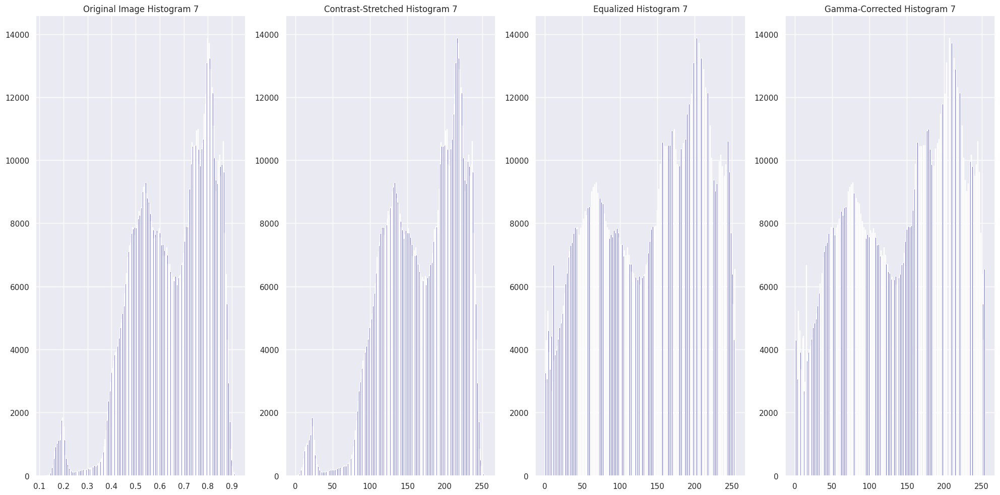

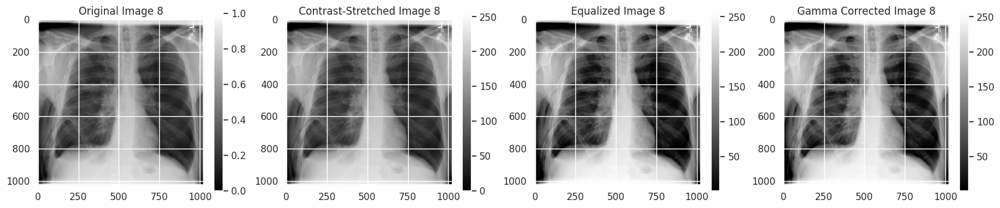

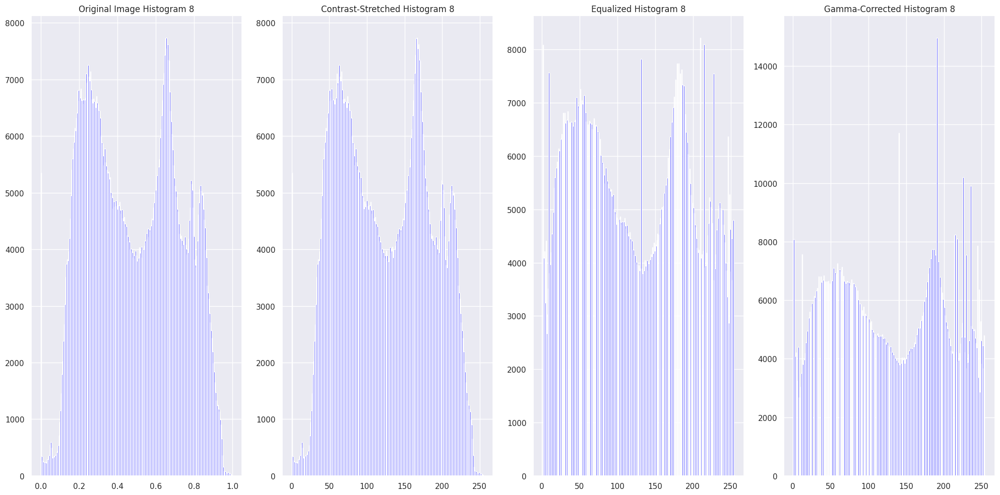

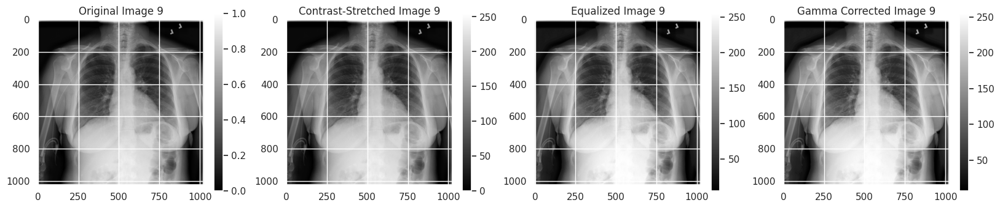

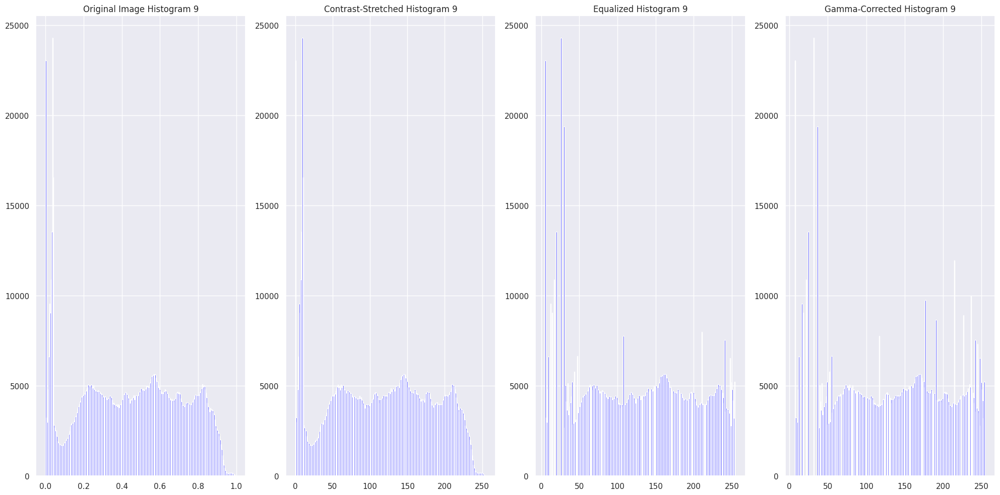

In [83]:
for i in range(9):
    plt.figure(figsize=(20, 40))
    sample_img = random_images[i]
    raw_image = plt.imread(os.path.join(img_dir, sample_img))

    min_val, max_val = raw_image.min(), raw_image.max()

    # Apply contrast stretching
    min_val, max_val = raw_image.min(), raw_image.max()
    contrast_stretched = (raw_image - min_val) / (max_val - min_val)
    contrast_stretched = (contrast_stretched * 255).astype(np.uint8)

    # Apply histogram equalization after contrast stretching
    # Apply histogram equalization using skimage
    equalized_image = exposure.equalize_hist(contrast_stretched)
    equalized_image = (equalized_image * 255).astype(np.uint8)


    # Apply gamma correction on the equalized image
    gamma = 0.9
    gamma_corrected = np.power(equalized_image / 255.0, gamma) * 255
    gamma_corrected = gamma_corrected.astype(np.uint8)

    # Plot
    plt.subplot(9, 4, i * 4 + 1)
    plt.imshow(raw_image, cmap='gray')
    plt.title(f'Original Image {i+1}')
    plt.colorbar()

    plt.subplot(9, 4, i * 4 + 2)
    plt.imshow(contrast_stretched, cmap='gray')
    plt.title(f'Contrast-Stretched Image {i+1}')
    plt.colorbar()

    plt.subplot(9, 4, i * 4 + 3)
    plt.imshow(equalized_image, cmap='gray')
    plt.title(f'Equalized Image {i+1}')
    plt.colorbar()

    plt.subplot(9, 4, i * 4 + 4)
    plt.imshow(gamma_corrected, cmap='gray')
    plt.title(f'Gamma Corrected Image {i+1}')
    plt.colorbar()

    # Histogram
    plt.figure(figsize=(20, 10))
    plt.subplot(1, 4, 1)
    plt.hist(raw_image.ravel(), bins=256, color='blue')
    plt.title(f"Original Image Histogram {i+1}")

    plt.subplot(1, 4, 2)
    plt.hist(contrast_stretched.ravel(), bins=256, color='blue')
    plt.title(f"Contrast-Stretched Histogram {i+1}")

    plt.subplot(1, 4, 3)
    plt.hist(equalized_image.ravel(), bins=256, color='blue')
    plt.title(f"Equalized Histogram {i+1}")

    plt.subplot(1, 4, 4)
    plt.hist(gamma_corrected.ravel(), bins=256, color='blue')
    plt.title(f"Gamma-Corrected Histogram {i+1}")

    plt.tight_layout()
    plt.show()

###Gamma Azaltılması
Gamma değerinin 0.9 yapılması, görüntünün parlaklığını artırma yönünde bir etki yapmıştır.

Görüntünler daha aydınlık halegelmiştir.
Koyu bölgeler daha fazla detay içermektedir.
Orta tonlar daha belirgin hale gelmiştir.
Çok parlak bölgeler büyük ölçüde aynı kalmış, bu da gamma düzeltmesinin parlaklık artırıcı etkisinin koyu tonlarda daha yoğun olduğunu göstermektedir.

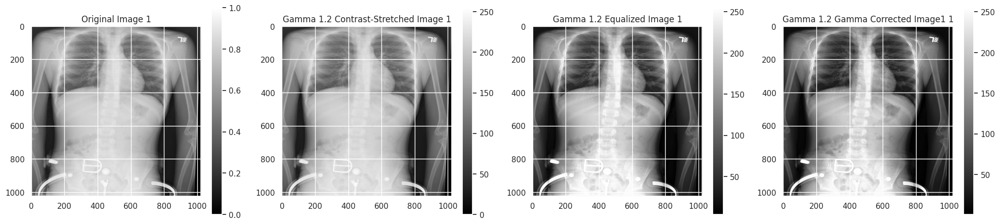

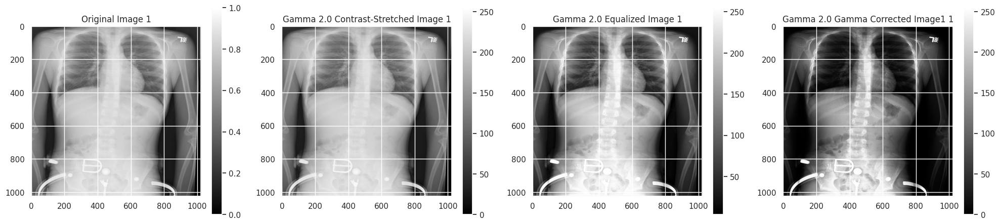

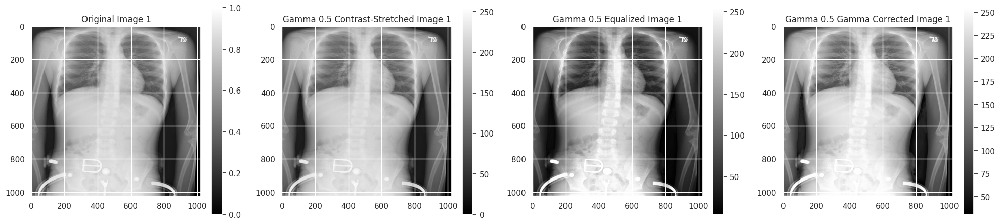

In [84]:
    plt.figure(figsize=(20, 40))
    sample_img = random_images[0]
    raw_image = plt.imread(os.path.join(img_dir, sample_img))

    min_val, max_val = raw_image.min(), raw_image.max()

    # Apply contrast stretching
    min_val, max_val = raw_image.min(), raw_image.max()
    contrast_stretched1 = (raw_image - min_val) / (max_val - min_val)  # Normalize to [0, 1]
    contrast_stretched1 = (contrast_stretched1 * 255).astype(np.uint8)  # Scale to [0, 255] for visualization

    # Apply histogram equalization after contrast stretching
    # Apply histogram equalization using skimage
    equalized_image1 = exposure.equalize_hist(contrast_stretched1)  # Returns values in [0, 1]
    equalized_image1 = (equalized_image1 * 255).astype(np.uint8)    # Scale to [0, 255]


    # Apply gamma correction on the equalized image
    gamma = 1.2
    gamma_corrected1 = np.power(equalized_image1 / 255.0, gamma) * 255
    gamma_corrected1 = gamma_corrected1.astype(np.uint8)

    # Plot
    plt.subplot(9, 4, 5)
    plt.imshow(raw_image, cmap='gray')
    plt.title(f'Original Image {1}')
    plt.colorbar()

    plt.subplot(9, 4, 6)
    plt.imshow(contrast_stretched1, cmap='gray')
    plt.title(f'Gamma 1.2 Contrast-Stretched Image {1}')
    plt.colorbar()

    plt.subplot(9, 4, 7)
    plt.imshow(equalized_image1, cmap='gray')
    plt.title(f'Gamma 1.2 Equalized Image {1}')
    plt.colorbar()

    plt.subplot(9, 4, 8)
    plt.imshow(gamma_corrected1, cmap='gray')
    plt.title(f'Gamma 1.2 Gamma Corrected Image1 {1}')
    plt.colorbar()

    plt.tight_layout()
    plt.show()
###
    plt.figure(figsize=(20, 40))
    sample_img = random_images[0]
    raw_image = plt.imread(os.path.join(img_dir, sample_img))

    min_val, max_val = raw_image.min(), raw_image.max()

    # Apply contrast stretching
    min_val, max_val = raw_image.min(), raw_image.max()
    contrast_stretched2 = (raw_image - min_val) / (max_val - min_val)
    contrast_stretched2 = (contrast_stretched2 * 255).astype(np.uint8)

    # Apply histogram equalization after contrast stretching
    # Apply histogram equalization using skimage
    equalized_image2 = exposure.equalize_hist(contrast_stretched2)
    equalized_image2 = (equalized_image2 * 255).astype(np.uint8)


    # Apply gamma correction on the equalized image
    gamma = 2.0
    gamma_corrected2 = np.power(equalized_image2 / 255.0, gamma) * 255
    gamma_corrected2 = gamma_corrected2.astype(np.uint8)

    # Plot
    plt.subplot(9, 4, 5)
    plt.imshow(raw_image, cmap='gray')
    plt.title(f'Original Image {1}')
    plt.colorbar()

    plt.subplot(9, 4, 6)
    plt.imshow(contrast_stretched2, cmap='gray')
    plt.title(f'Gamma 2.0 Contrast-Stretched Image {1}')
    plt.colorbar()

    plt.subplot(9, 4, 7)
    plt.imshow(equalized_image2, cmap='gray')
    plt.title(f'Gamma 2.0 Equalized Image {1}')
    plt.colorbar()

    plt.subplot(9, 4, 8)
    plt.imshow(gamma_corrected2, cmap='gray')
    plt.title(f'Gamma 2.0 Gamma Corrected Image1 {1}')
    plt.colorbar()

    plt.tight_layout()
    plt.show()

###
    plt.figure(figsize=(20, 40))
    sample_img = random_images[0]
    raw_image = plt.imread(os.path.join(img_dir, sample_img))

    min_val, max_val = raw_image.min(), raw_image.max()

    # Apply contrast stretching
    min_val, max_val = raw_image.min(), raw_image.max()
    contrast_stretched3 = (raw_image - min_val) / (max_val - min_val)
    contrast_stretched3 = (contrast_stretched3 * 255).astype(np.uint8)

    # Apply histogram equalization after contrast stretching
    # Apply histogram equalization using skimage
    equalized_image3 = exposure.equalize_hist(contrast_stretched3)
    equalized_image3 = (equalized_image3 * 255).astype(np.uint8)


    # Apply gamma correction on the equalized image
    gamma = 0.5
    gamma_corrected3 = np.power(equalized_image3 / 255.0, gamma) * 255
    gamma_corrected3 = gamma_corrected3.astype(np.uint8)

    # Plot
    plt.subplot(9, 4, 5)
    plt.imshow(raw_image, cmap='gray')
    plt.title(f'Original Image {1}')
    plt.colorbar()

    plt.subplot(9, 4, 6)
    plt.imshow(contrast_stretched3, cmap='gray')
    plt.title(f'Gamma 0.5 Contrast-Stretched Image {1}')
    plt.colorbar()

    plt.subplot(9, 4, 7)
    plt.imshow(equalized_image3, cmap='gray')
    plt.title(f'Gamma 0.5 Equalized Image {1}')
    plt.colorbar()

    plt.subplot(9, 4, 8)
    plt.imshow(gamma_corrected3, cmap='gray')
    plt.title(f'Gamma 0.5 Gamma Corrected Image {1}')
    plt.colorbar()

    plt.tight_layout()
    plt.show()

###Gamma Değişimleri Özet
İlk örnek görüntü için gamma değerlerinde büyük değişimlere gidildiğinde görülen farklılıklar yukarıda özet olarak ortaya konup bariz şekilde farklar görüntülenmiştir. Gamma azaldıkça görüntüdeki aydınlık hali artmakta, arttıkça aydınlıklar azalmaktadır.

## Görüntülerde ve Histogramlardaki Değişimler
### "Contrast-Stretched Image"
olarak düzenlenen görüntüler için kontrast artırılmıştır. Bu işlem sayesinde daha önce çok karanlık veya çok parlak görülen bölgelerin detayları ortaya çıkmaya başlamıştır.

### "Equalized Image"
yönteminde histogram eşitleme yapılmıştır. Bu yöntemle parlaklık dağılımı daha dengeli bir hale getirilmiştir. Bu sayede daha fazla detayın ortaya çıkması beklenmektedir. Koyu bölgeler aydınlatılmış, çok parlak alanlar ise dengelenmiştir. Yani genel parlaklık seviyesi daha dengeli bir hale gelmektedir.

## "Gamma Corrected Image"
gamma dönüşümü uygulanan görüntülerde orta parlaklık seviyeleri arttırılmış veya azaltılmıştır. Diğer yöntemlerden farklı olarak parlaklık ve kontrastı doğrudan yeniden dağıtmak yerine daha yumuşak bir etki sağlamıştır.

<Figure size 2000x4000 with 0 Axes>

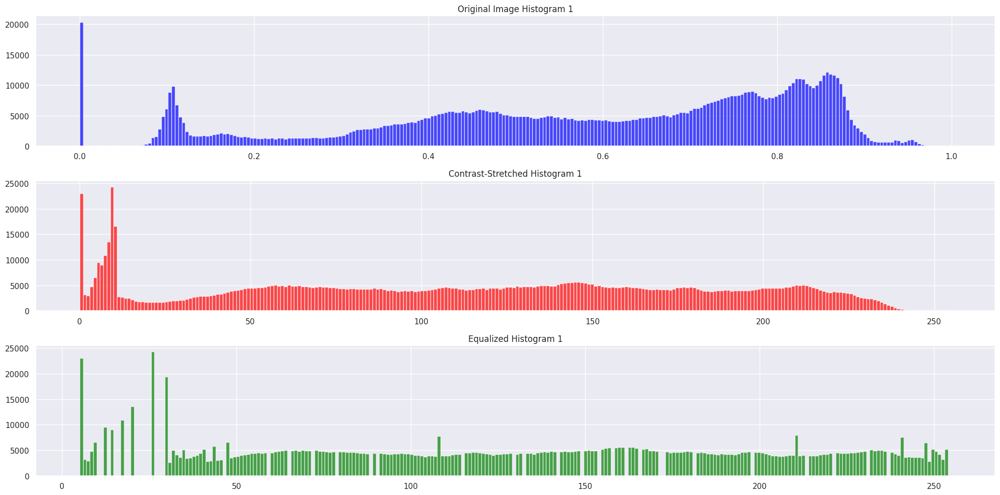

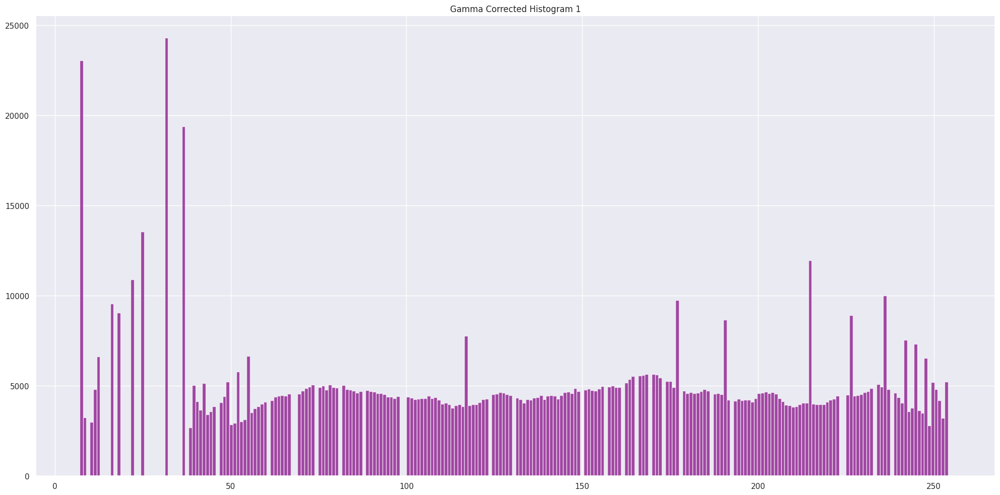

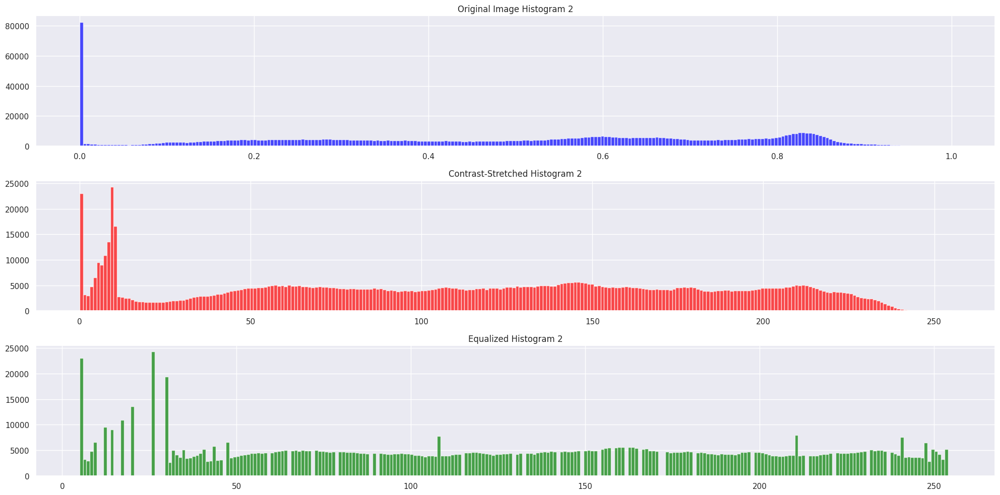

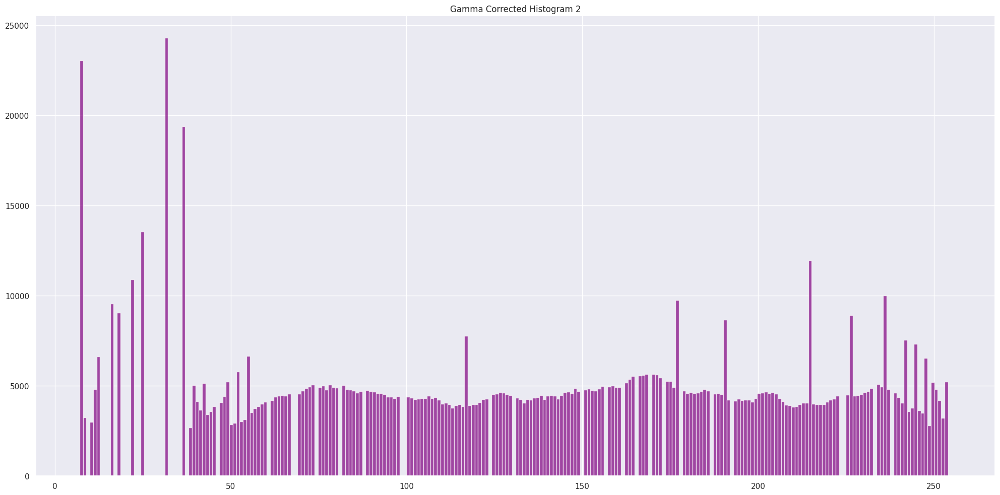

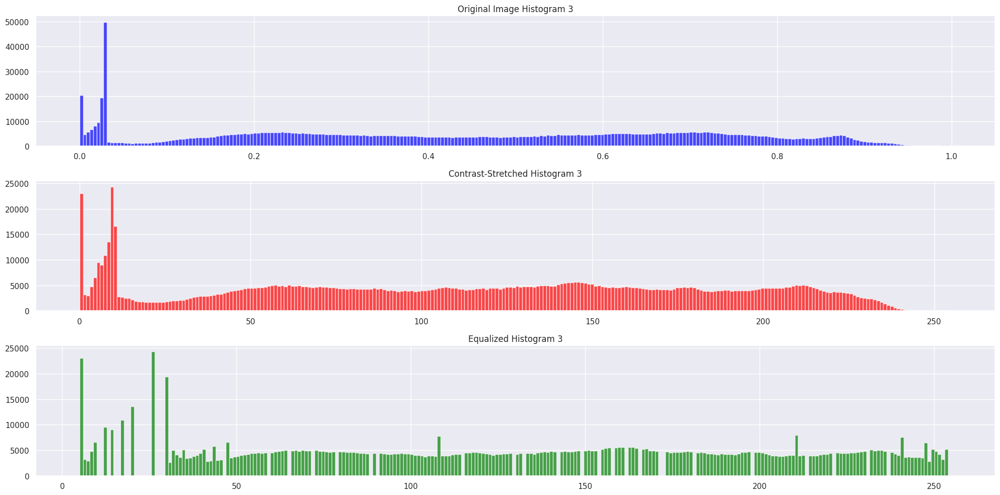

...

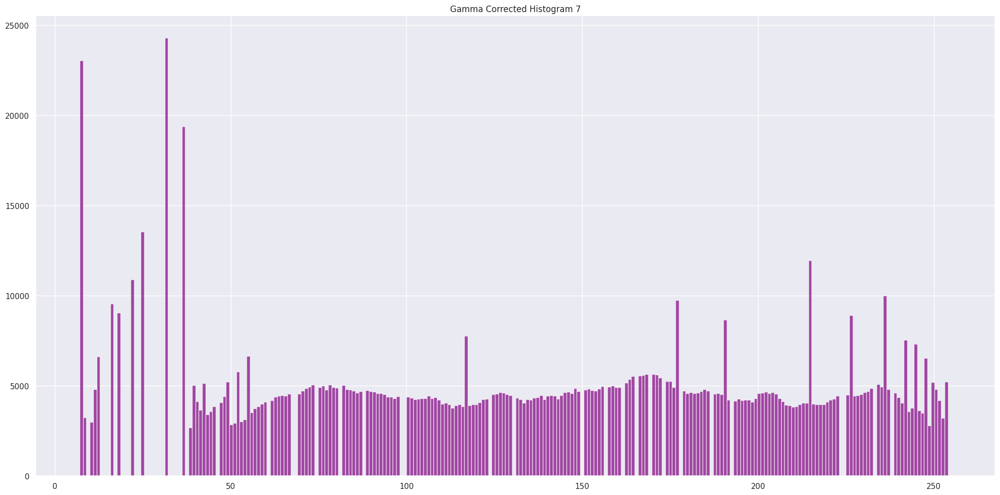

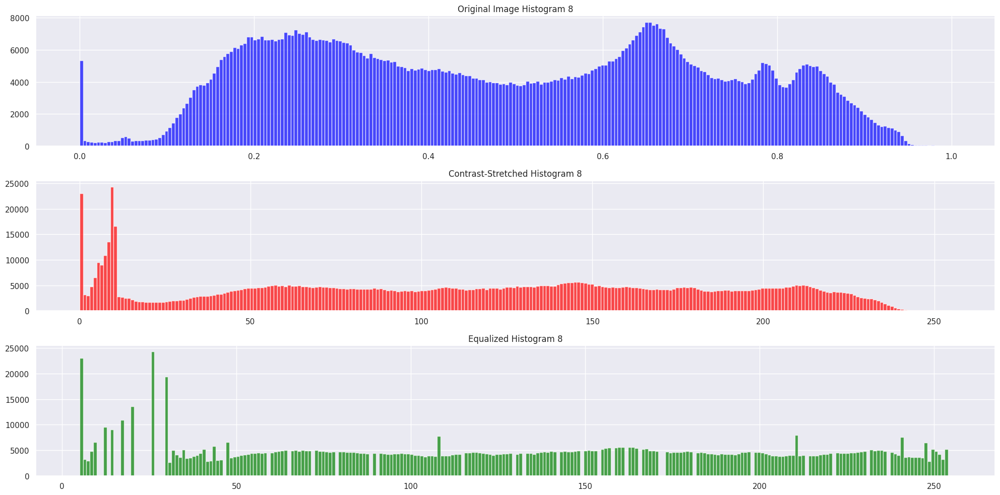

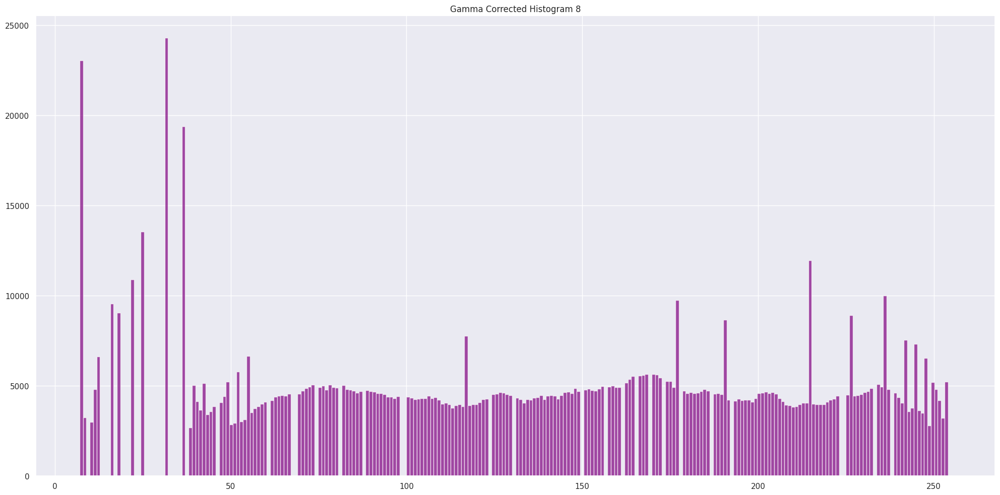

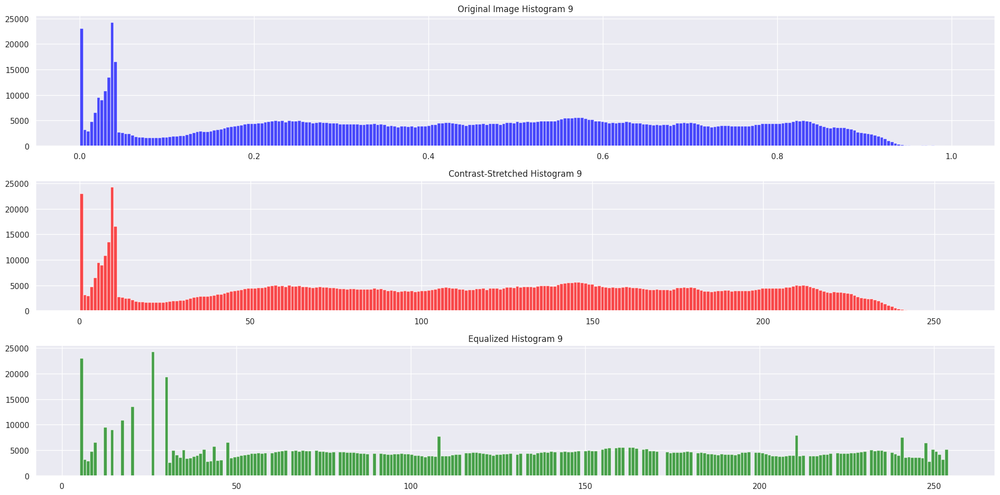

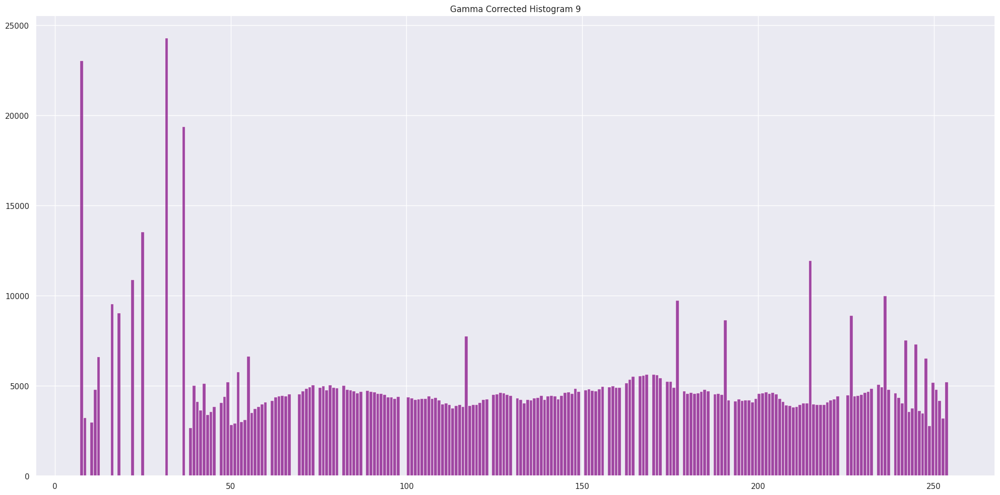

In [85]:
plt.figure(figsize=(20, 40))

for i in range(9):
    sample_img = random_images[i]
    raw_image = plt.imread(os.path.join(img_dir, sample_img))

    plt.figure(figsize=(20, 10))
    plt.subplot(3, 1, 1)
    plt.hist(raw_image.ravel(), bins=256, color='blue', alpha=0.7)  # Adjust alpha for transparency
    plt.title(f"Original Image Histogram {i+1}")

    plt.subplot(3, 1, 2)
    plt.hist(contrast_stretched.ravel(), bins=256, color='red', alpha=0.7)
    plt.title(f"Contrast-Stretched Histogram {i+1}")

    plt.subplot(3, 1, 3)
    plt.hist(equalized_image.ravel(), bins=256, color='green', alpha=0.7)
    plt.title(f"Equalized Histogram {i+1}")

    plt.tight_layout()
    plt.show()

    plt.figure(figsize=(20, 10))
    plt.hist(gamma_corrected.ravel(), bins=256, color='purple', alpha=0.7)
    plt.title(f"Gamma Corrected Histogram {i+1}")
    plt.tight_layout()
    plt.show()

<ipython-input-86-ae12330db2fc>:1: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751

  sns.distplot(gamma_corrected.ravel(),


Text(0, 0.5, '# Pixels in Image')

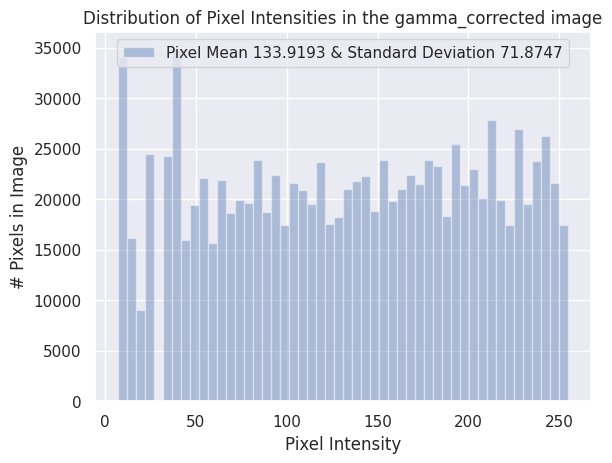

In [86]:
sns.distplot(gamma_corrected.ravel(),
             label=f'Pixel Mean {np.mean(gamma_corrected):.4f} & Standard Deviation {np.std(gamma_corrected):.4f}', kde=False)
plt.legend(loc='upper center')
plt.title('Distribution of Pixel Intensities in the gamma_corrected image')
plt.xlabel('Pixel Intensity')
plt.ylabel('# Pixels in Image')

TUM GORUNTULERE EMDIAN VE GAUSSIAN BLUR UYGULAYIN

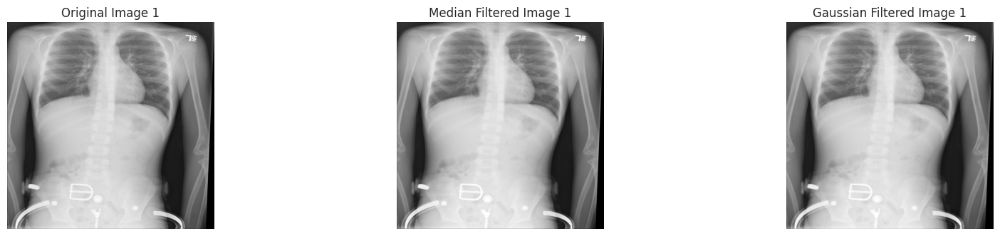

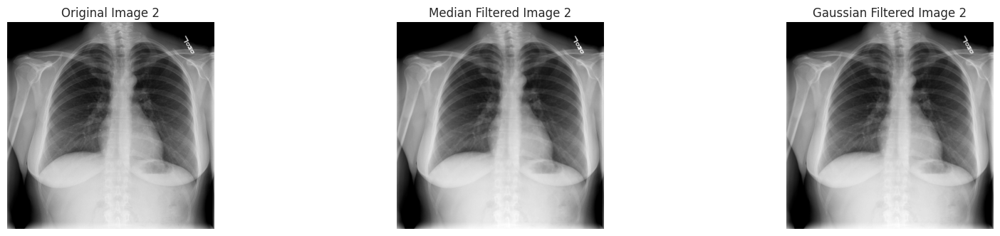

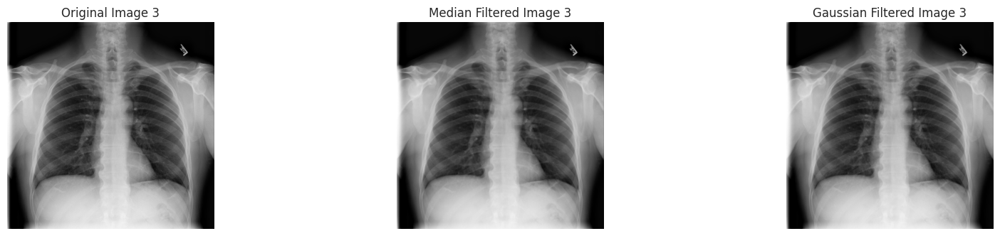

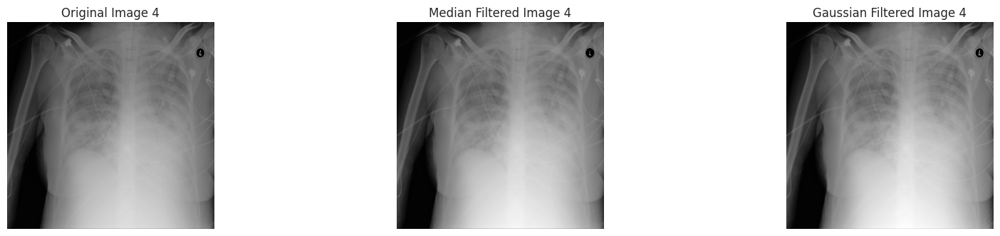

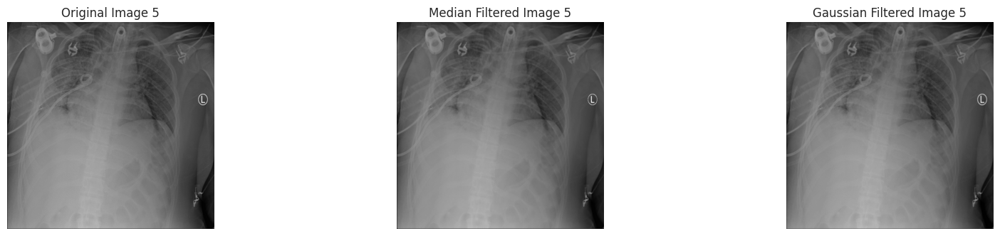

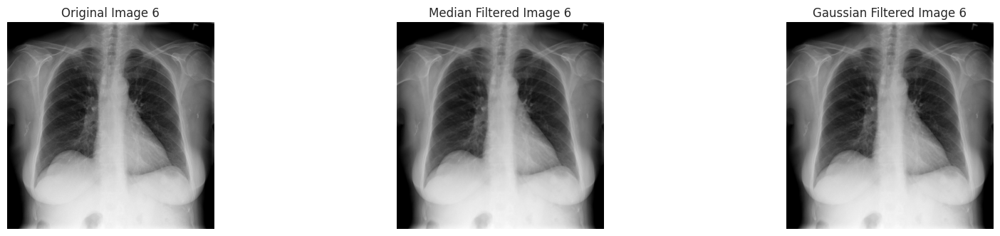

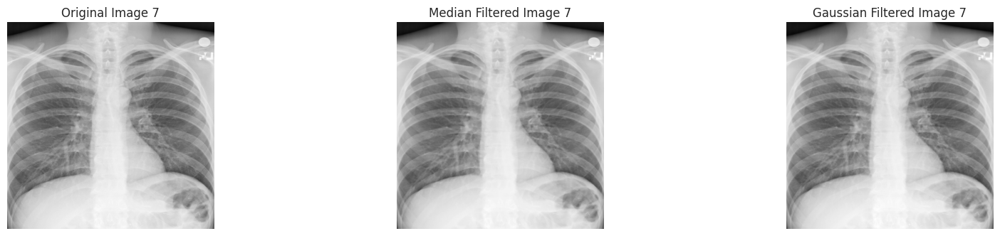

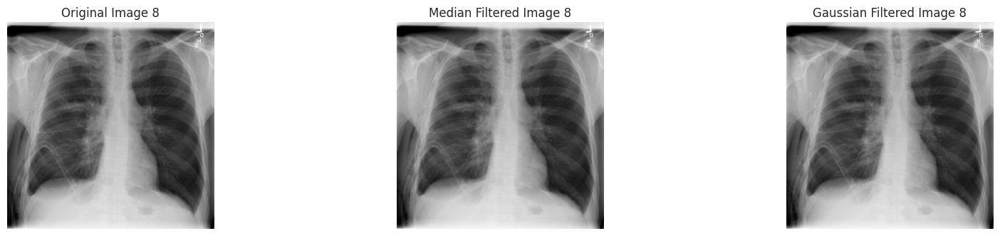

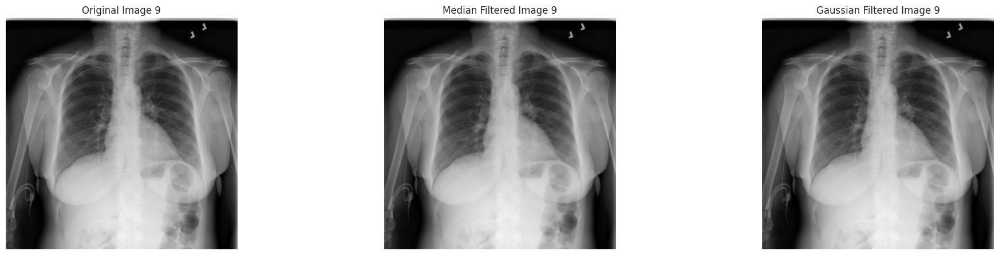

In [87]:
for i in range(9):
    plt.figure(figsize=(20, 40))
    sample_img = random_images[i]
    raw_image = plt.imread(os.path.join(img_dir, sample_img))

    median_filtered = cv2.medianBlur(raw_image, 5)
    gaussian_filtered = cv2.GaussianBlur(raw_image, (5, 5), 0)

    # Plot
    plt.subplot(9, 3, i * 3 + 1)
    plt.imshow(raw_image, cmap='gray')
    plt.title(f'Original Image {i+1}')
    plt.axis('off')

    plt.subplot(9, 3, i * 3 + 2)
    plt.imshow(median_filtered, cmap='gray')
    plt.title(f'Median Filtered Image {i+1}')
    plt.axis('off')

    plt.subplot(9, 3, i * 3 + 3)
    plt.imshow(gaussian_filtered, cmap='gray')
    plt.title(f'Gaussian Filtered Image {i+1}')
    plt.axis('off')

plt.tight_layout()
plt.show()

##Median Blurred
Median bulanıklaştırma yöntemi, görüntüdeki her pikselin çevresindeki komşu piksellerin medyan değerini alarak uygulanmaktadır. Görüntünün kenar bölgeleri korunmuş ve konturların netliği büyük ölçüde muhafaza edilmiştir. Örneğin, akciğer sınırları ve kemik yapıları median filtreden sonra hala net bir şekilde görülebilmektedir. İnce detaylar korunurken, özellikle gürültü içeren alanlarda belirgin bir iyileşme sağlanmıştır.

##Gaussian Blurred
Gaussian bulanıklaştırma yöntemi, her pikselin değerini çevresindeki piksellerin ağırlıklı ortalamasıyla değiştirerek uygulanmaktadır. Bu ağırlıklandırma, Gaussian dağılımına göre yapılır ve çevredeki piksellerin uzaklığına bağlıdır.Görüntü genelinde daha yumuşak bir görünüm elde edilmiştir. Gürültü homojen bir şekilde azaltılmış ve geniş alanlarda pürüzsüzleştirme sağlanmıştır.
Ancak, median filtreye kıyasla detaylarda bir miktar kayıp yaşanmıştır. Özellikle keskin kenarlar (örneğin, akciğer ve kemik sınırları) Gaussian bulanıklaştırma sonrası daha yumuşak bir görünüm almıştır.

In [ ]:
#import cv2  # opencv for python package

# Apply Median Filtering
#median_filtered = cv2.medianBlur(gamma_corrected, 5)

# Apply Gaussian Blur
#gaussian_filtered = cv2.GaussianBlur(gamma_corrected, (5, 5), 0)

# Display Results
#plt.figure(figsize=(12, 6))
#plt.subplot(1, 2, 1), plt.imshow(median_filtered, cmap='gray'), plt.title("Median Filtered Image")
#plt.subplot(1, 2, 2), plt.imshow(gaussian_filtered, cmap='gray'), plt.title("Gaussian Filtered Image")
#plt.show()


DERECESI RASTGELE 0 ILA 10 ARASINDA OLACAK SEKILDE ROTATION UYGULAYIN GORUNTUYE FLIPPING UYGULAYIN

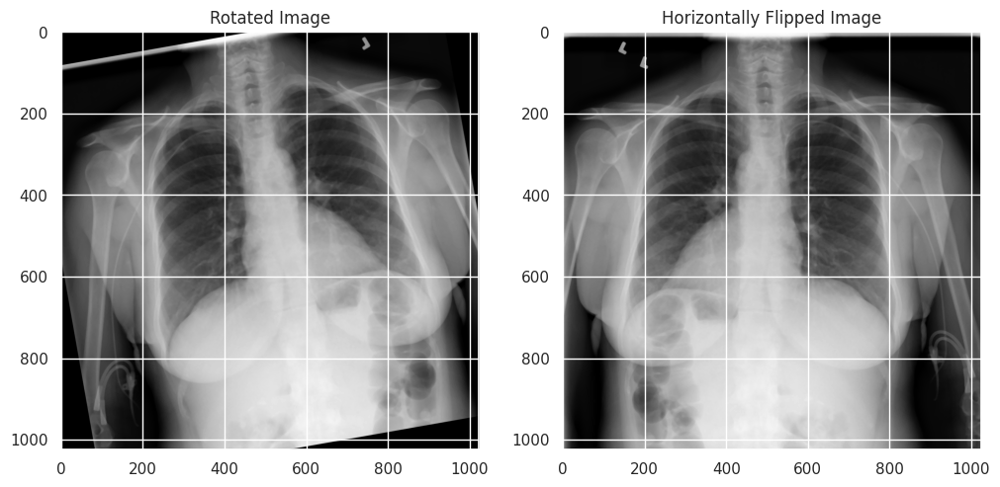

In [88]:
# Example: Rotate the image by 10 degrees
center = (median_filtered.shape[1] // 2, median_filtered.shape[0] // 2)
rotation_matrix = cv2.getRotationMatrix2D(center, angle=10, scale=1.0)
rotated_image = cv2.warpAffine(median_filtered, rotation_matrix, (median_filtered.shape[1], median_filtered.shape[0]))

# Horizontal Flip
flipped_horizontal = cv2.flip(median_filtered, 1)

# Display Results
plt.figure(figsize=(12, 6))
plt.subplot(1, 2, 1), plt.imshow(rotated_image, cmap='gray'), plt.title("Rotated Image")
plt.subplot(1, 2, 2), plt.imshow(flipped_horizontal, cmap='gray'), plt.title("Horizontally Flipped Image")
plt.show()


##Tüm görüntülere rotate ve flip uygulanmamıştır.

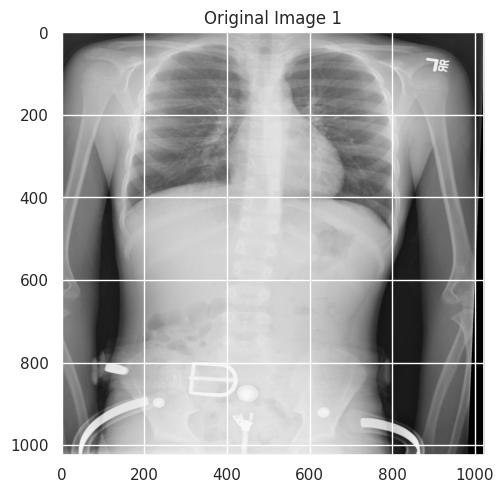

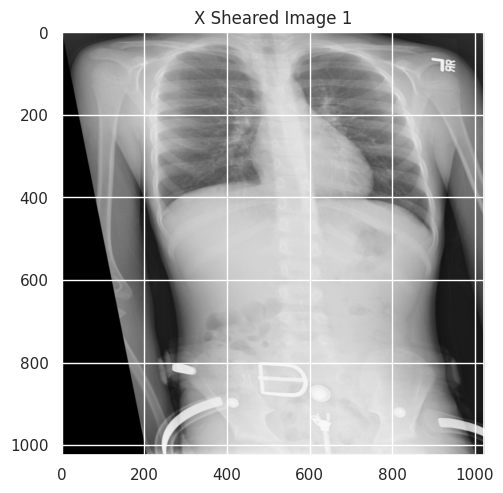

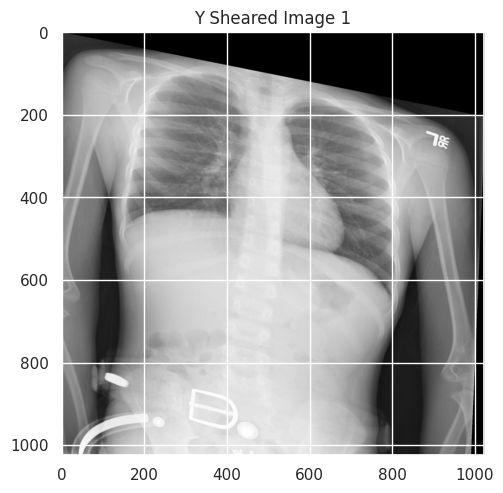

In [89]:
# Görüntüyü yükleme
sample_img = random_images[0]
raw_image = plt.imread(os.path.join(img_dir, sample_img))
rows, cols = raw_image.shape[:2]

plt.figure(figsize=(12, 6))
plt.subplot(1, 2, 1), plt.imshow(raw_image, cmap='gray'), plt.title("Original Image 1")
plt.show()

# X ekseninde shearing
shear_matrix = np.float32([[1, 0.2, 0], [0, 1, 0]])
sheared_image = cv2.warpAffine(raw_image, shear_matrix, (cols, rows))
plt.figure(figsize=(12, 6))
plt.subplot(1, 2, 1), plt.imshow(sheared_image, cmap='gray'), plt.title("X Sheared Image 1")
##plt.subplot(1, 2, 2), plt.imshow(flipped_horizontal, cmap='gray'), plt.title("Horizontally Flipped Image")
plt.show()

# Y ekseninde shearing
shear_matrix = np.float32([[1, 0, 0], [0.2, 1, 0]])
sheared_image = cv2.warpAffine(raw_image, shear_matrix, (cols, rows))
plt.figure(figsize=(12, 6))
plt.subplot(1, 2, 1), plt.imshow(sheared_image, cmap='gray'), plt.title("Y Sheared Image 1")
##plt.subplot(1, 2, 2), plt.imshow(flipped_horizontal, cmap='gray'), plt.title("Horizontally Flipped Image")
plt.show()


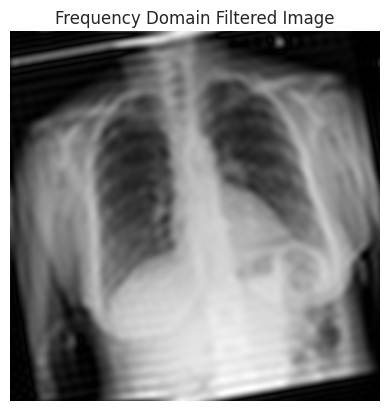

In [90]:
# Apply Fourier Transform and shift it to center low frequencies
dft = cv2.dft(np.float32(rotated_image), flags=cv2.DFT_COMPLEX_OUTPUT)
dft_shifted = np.fft.fftshift(dft)

# Create a mask for filtering
rows, cols = rotated_image.shape
crow, ccol = rows // 2 , cols // 2
mask = np.zeros((rows, cols, 2), np.uint8)
mask[crow-30:crow+30, ccol-30:ccol+30] = 1  # Center low frequencies pass

# Apply mask and inverse DFT
fshift = dft_shifted * mask
f_ishift = np.fft.ifftshift(fshift)
filtered_image = cv2.idft(f_ishift)
filtered_image = cv2.magnitude(filtered_image[:, :, 0], filtered_image[:, :, 1])

# Normalize and display the filtered image
filtered_image = cv2.normalize(filtered_image, None, 0, 255, cv2.NORM_MINMAX)
plt.imshow(filtered_image, cmap='gray')
plt.title("Frequency Domain Filtered Image")
plt.axis("off")
plt.show()


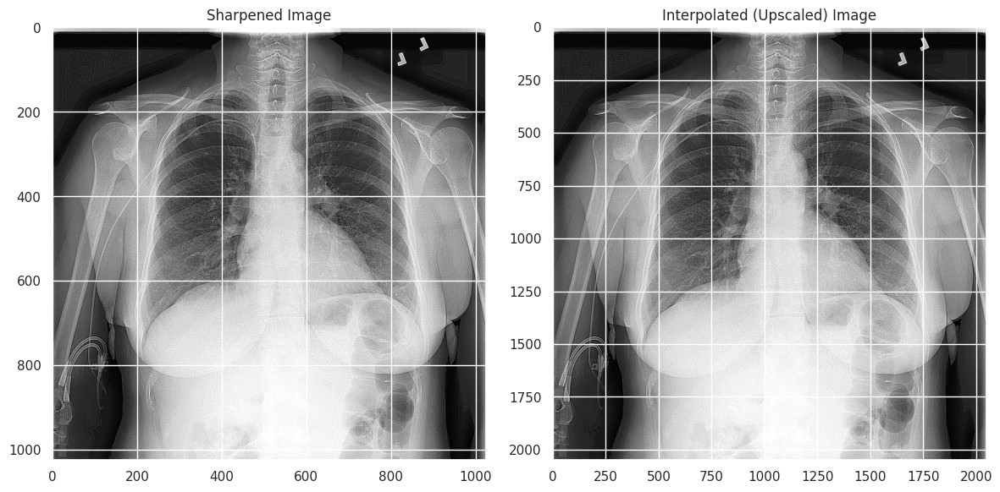

In [91]:
# Apply sharpening using an unsharp masking kernel
sharpening_kernel = np.array([[-1, -1, -1],
                              [-1,  9, -1],
                              [-1, -1, -1]])
sharpened_image = np.clip(cv2.filter2D(gamma_corrected, -1, sharpening_kernel), 0, 255).astype(np.uint8)

# Apply bicubic interpolation to upscale the image by a factor of 2
scale_factor = 2
resized_image = zoom(sharpened_image, scale_factor, order=3)  # Bicubic interpolation with `order=3`

plt.figure(figsize=(12, 6))
plt.subplot(1, 2, 1), plt.imshow(sharpened_image, cmap='gray'),plt.title("Sharpened Image")
plt.subplot(1, 2, 2), plt.imshow(resized_image, cmap='gray'),plt.title("Interpolated (Upscaled) Image")


plt.tight_layout()
plt.show()

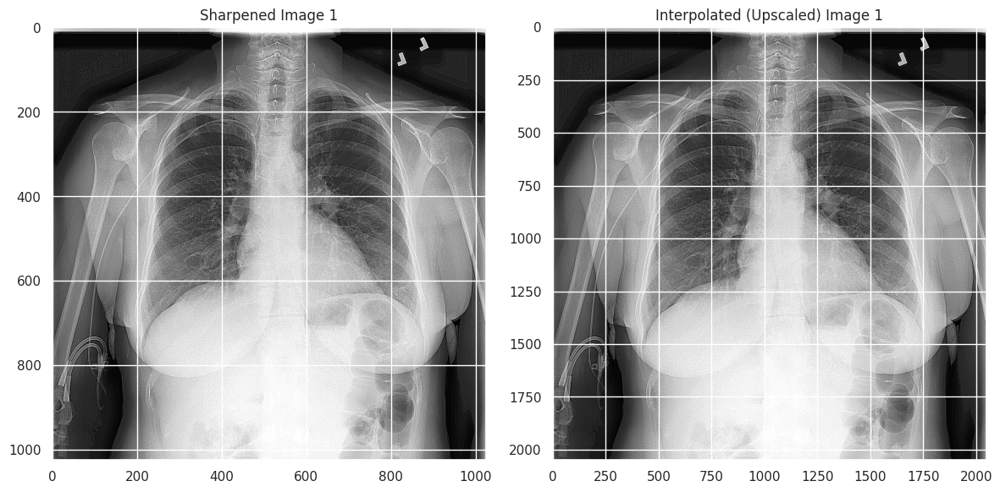

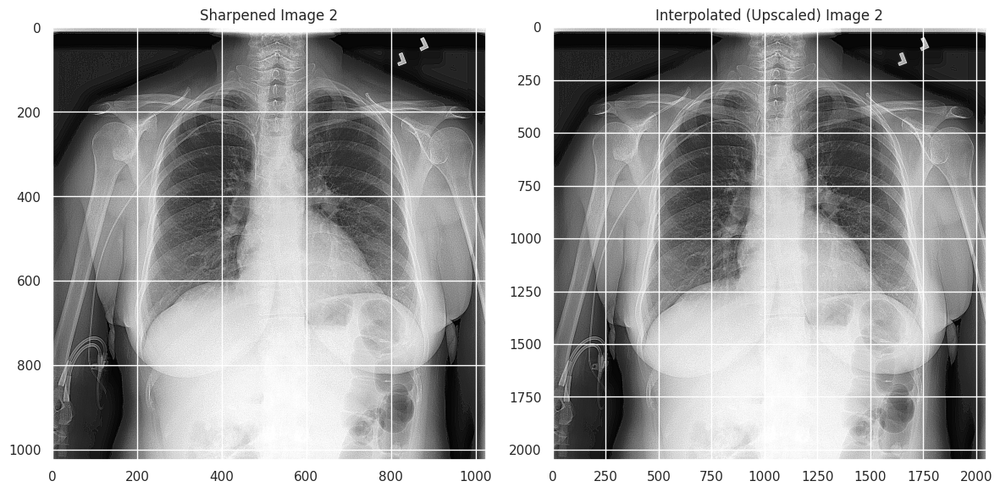

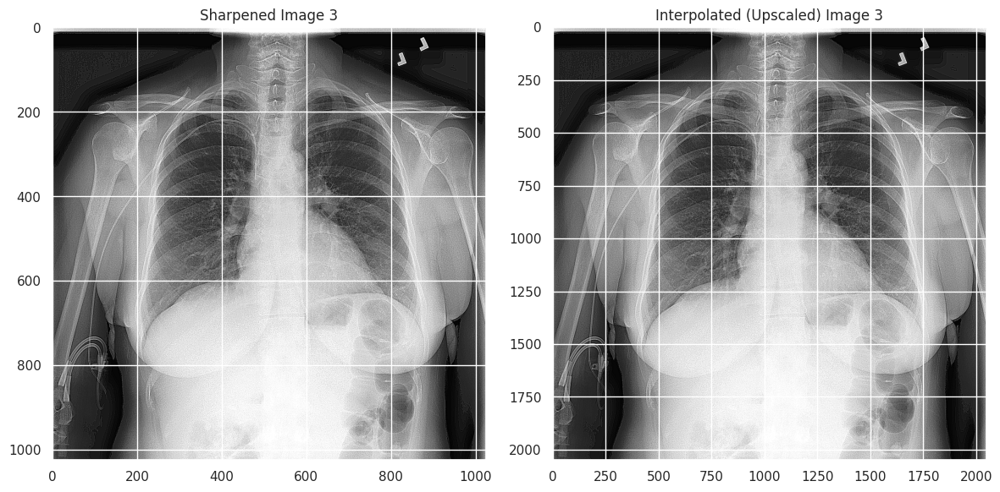

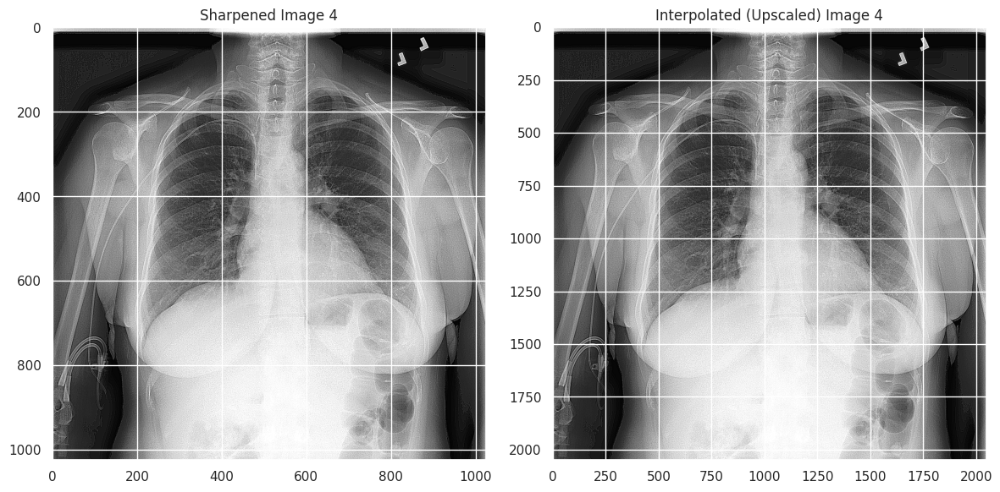

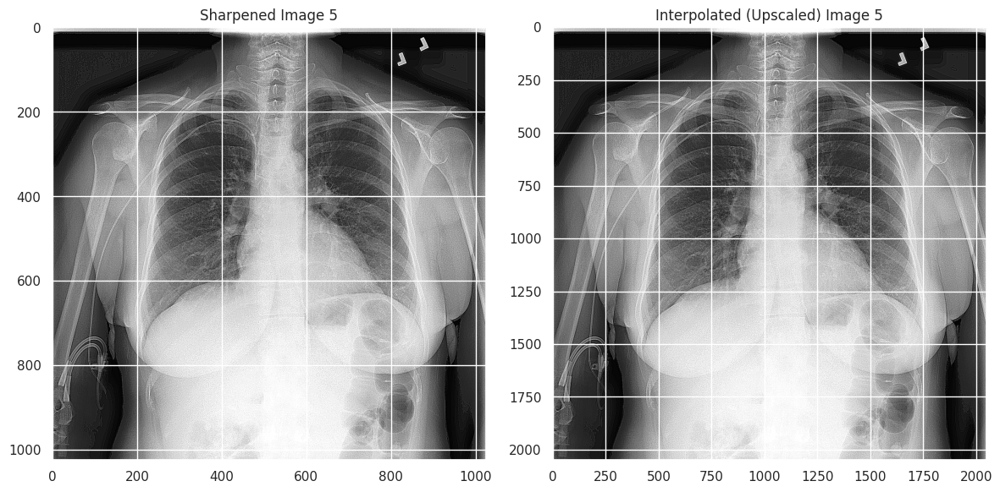

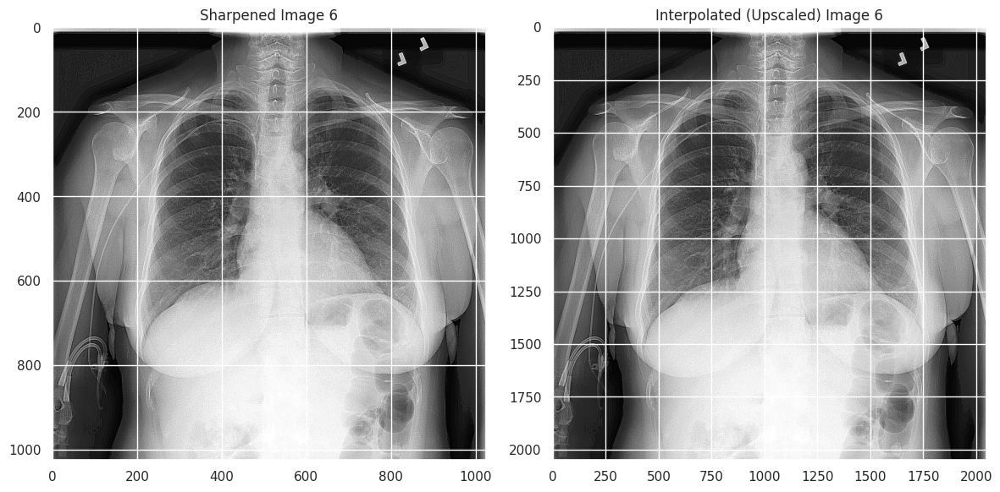

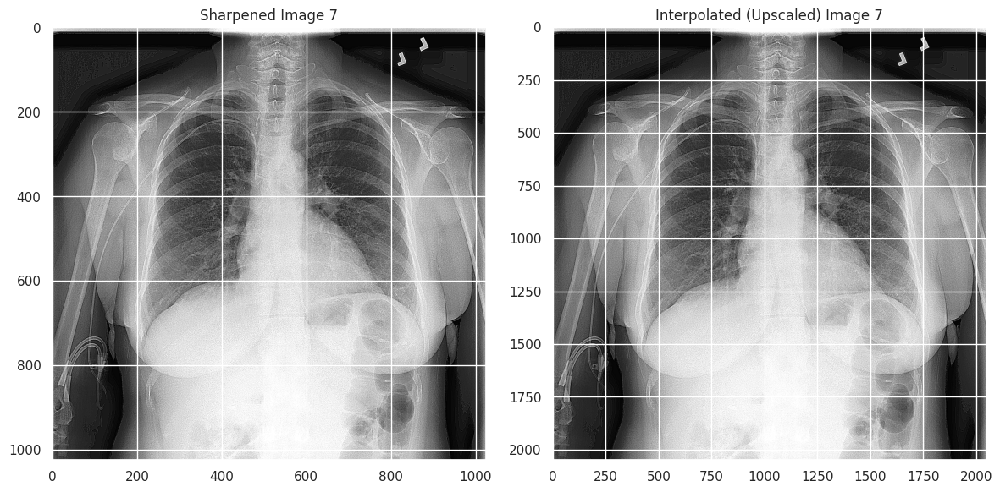

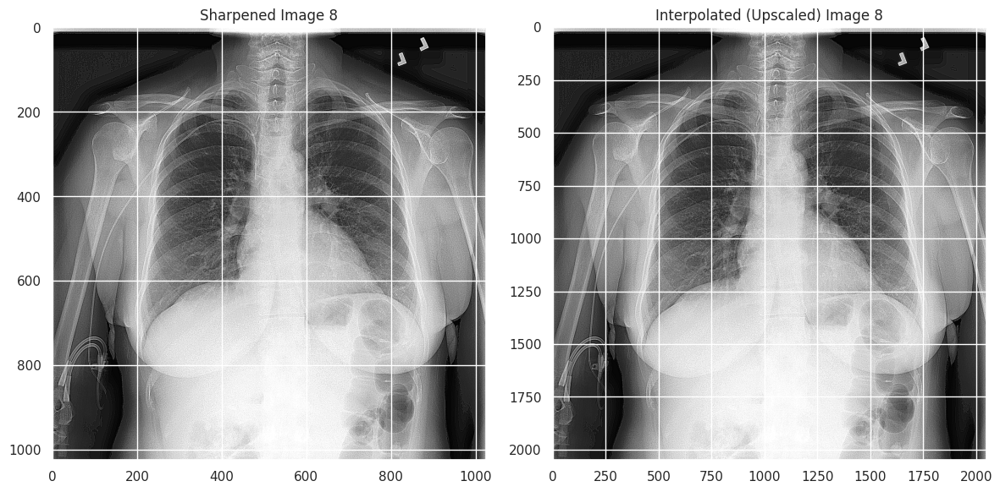

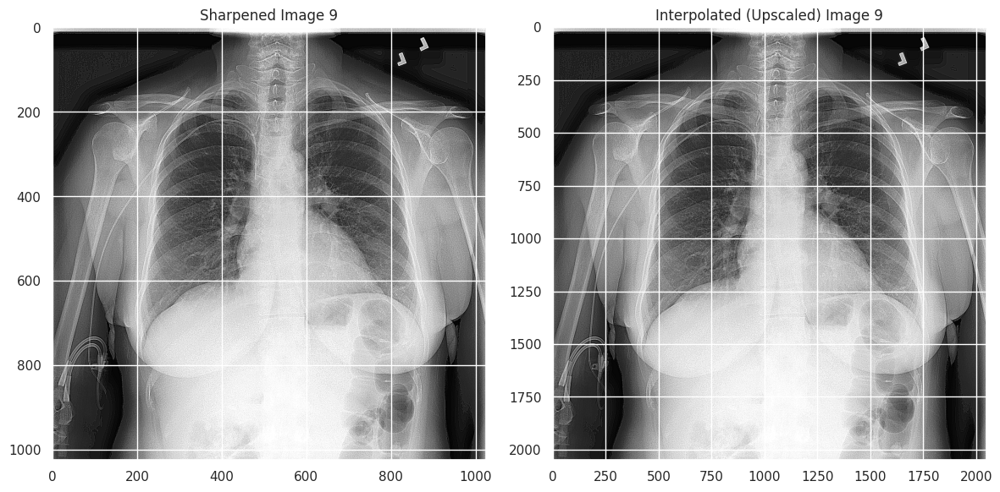

In [92]:
for i in range(9):
    sample_img = random_images[i]
    raw_image = plt.imread(os.path.join(img_dir, sample_img))

    ##Apply sharpening using an unsharp masking kernel
    sharpening_kernel = np.array([[-1, -1, -1],
                                  [-1,  9, -1],
                                  [-1, -1, -1]])
    sharpened_image = np.clip(cv2.filter2D(gamma_corrected, -1, sharpening_kernel), 0, 255).astype(np.uint8)

    ##Apply bicubic interpolation to upscale the image by a factor of 2
    scale_factor = 2
    resized_image = zoom(sharpened_image, scale_factor, order=3)  # Bicubic interpolation with `order=3`

    plt.figure(figsize=(12, 6))
    plt.subplot(1, 2, 1), plt.imshow(sharpened_image, cmap='gray'), plt.title(f"Sharpened Image {i+1}")
    plt.subplot(1, 2, 2), plt.imshow(resized_image, cmap='gray'), plt.title(f"Interpolated (Upscaled) Image {i+1}")
    plt.tight_layout()
    plt.show()